<a href="https://colab.research.google.com/github/successfuljosh/ParkingSpaceDetection/blob/main/ParkingSpaceDetector.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
os.chdir('/content/drive/My Drive/MaskRCNN/')

In [ ]:
!ls

assets	       Josh2		     output_video2.mp4	   setup.cfg
build	       Josh_G		     output_video3.mp4	   setup.py
DetectedCars   LICENSE		     output_video4.mp4	   test_images
dist	       MANIFEST.in	     output_video9834.mp4  test_videos
False	       mask_rcnn_coco.h5     output_video.mp4	   test.zip
Imageforplot   mask_rcnn.egg-info    Plots		   True
Imageforplot2  Mask_RCNN-master.zip  README.md
images	       mrcnn		     requirements.txt
Josh	       output_video1177.mp4  samples


In [ ]:
!pip uninstall tensorflow tensorflow-tensorboard tensorflow-estimator
# !pip install --no-deps tensorflow==1.15.3
# !pip install --no-deps keras==2.2.4
!pip install tensorflow==1.15.3
!pip install keras==2.2.4
!pip install h5py==2.10.0 --force-reinstall
# !pip install Keras-Applications

Found existing installation: tensorflow 2.7.0
Uninstalling tensorflow-2.7.0:
  Would remove:
    /usr/local/bin/estimator_ckpt_converter
    /usr/local/bin/import_pb_to_tensorboard
    /usr/local/bin/saved_model_cli
    /usr/local/bin/tensorboard
    /usr/local/bin/tf_upgrade_v2
    /usr/local/bin/tflite_convert
    /usr/local/bin/toco
    /usr/local/bin/toco_from_protos
    /usr/local/lib/python3.7/dist-packages/tensorflow-2.7.0.dist-info/*
    /usr/local/lib/python3.7/dist-packages/tensorflow/*
Proceed (y/n)? y
  Successfully uninstalled tensorflow-2.7.0
Found existing installation: tensorflow-estimator 2.7.0
Uninstalling tensorflow-estimator-2.7.0:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/tensorflow_estimator-2.7.0.dist-info/*
    /usr/local/lib/python3.7/dist-packages/tensorflow_estimator/*
Proceed (y/n)? y
  Successfully uninstalled tensorflow-estimator-2.7.0
     |████████████████████████████████| 110.5 MB 1.3 MB/s 
     |████████████████████████████████| 50 kB 

In [ ]:
!python setup.py install
!pip show mask-rcnn

/usr/local/lib/python3.7/dist-packages/setuptools/dist.py:700: UserWarning: Usage of dash-separated 'description-file' will not be supported in future versions. Please use the underscore name 'description_file' instead
  % (opt, underscore_opt))
/usr/local/lib/python3.7/dist-packages/setuptools/dist.py:700: UserWarning: Usage of dash-separated 'license-file' will not be supported in future versions. Please use the underscore name 'license_file' instead
  % (opt, underscore_opt))
/usr/local/lib/python3.7/dist-packages/setuptools/dist.py:700: UserWarning: Usage of dash-separated 'requirements-file' will not be supported in future versions. Please use the underscore name 'requirements_file' instead
  % (opt, underscore_opt))
running install
running bdist_egg
running egg_info
writing mask_rcnn.egg-info/PKG-INFO
writing dependency_links to mask_rcnn.egg-info/dependency_links.txt
writing top-level names to mask_rcnn.egg-info/top_level.txt
reading manifest file 'mask_rcnn.egg-info/SOURCES.txt

In [ ]:
#imports
import numpy as np
import cv2
import mrcnn.config
import mrcnn.utils
from mrcnn.model import MaskRCNN
import matplotlib as pt 
from pathlib import Path

Using TensorFlow backend.


In [ ]:
class MaskRCNNConfig(mrcnn.config.Config):
  NAME="coco_pretrained_model_config"
  IMAGES_PER_GPU = 1
  GPU_COUNT = 1
  NUM_CLASSES = 80 + 1
  DETECTION_MIN_CONFIDENCE = 0.6


In [ ]:
#CHECK GPU PROPS
!nvidia-smi

NVIDIA-SMI has failed because it couldn't communicate with the NVIDIA driver. Make sure that the latest NVIDIA driver is installed and running.



In [ ]:
!rm -r Josh
!mkdir Josh


### **Images Processing**

### Plotting IOU vs IsSpaceAvailable

In [ ]:
images = list(glob.iglob(os.path.join('./Imageforplot', '*.*')))
images = sorted(images, key=lambda x: int(os.path.split(x)[1][:-3].replace('.','').split(' ')[0]))
trues = list(glob.iglob(os.path.join('./True', '*.*')))
trues = sorted(trues, key=lambda x: float(os.path.split(x)[1][:-3]))
true_index = [int(os.path.split(x)[1][:-3].replace('.','')) for x in trues]
falses = list(glob.iglob(os.path.join('./False', '*.*')))
falses = sorted(falses, key=lambda x: float(os.path.split(x)[1][:-3]))
false_index = [int(os.path.split(x)[1][:-3].replace('.','')) for x in falses]
accurate_raw_val = [int(os.path.split(x)[1][:-3].replace('.','').split(' ')[1]) for x in images]
# for i in range(0,len(true_index)+len(false_index)):
#   if i in true_index:
#     accurate_val.append(True);
#   else:
#     accurate_val.append(False)
# len(accurate_val)

images, accurate_raw_val

(['./Imageforplot/0 0.jpg',
  './Imageforplot/1 0.jpg',
  './Imageforplot/2 1.jpg',
  './Imageforplot/3 1.jpg',
  './Imageforplot/4 1.jpg',
  './Imageforplot/5 0.jpg',
  './Imageforplot/6 0.jpg',
  './Imageforplot/7 0.jpg',
  './Imageforplot/8 0.jpg',
  './Imageforplot/9 0.jpg',
  './Imageforplot/10 2.jpg',
  './Imageforplot/11 2.jpg',
  './Imageforplot/12 2.jpg',
  './Imageforplot/13 2.jpg',
  './Imageforplot/14 2.jpg',
  './Imageforplot/15 2.jpg',
  './Imageforplot/16 2.jpg'],
 [0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2])

In [ ]:
iou_values = np.linspace(0.11,0.5, 5)
iou_values = [0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45]
iou_values = [round(x,2) for x in iou_values]
iou_values

[0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45]

### **Result and Analysis**

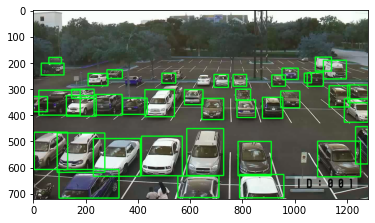

IndexError: ignored

In [ ]:
import os
import numpy as np
import cv2
import mrcnn.config
import mrcnn.utils
from mrcnn.model import MaskRCNN
from pathlib import Path
import glob
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Configuration that will be used by the Mask-RCNN library
class MaskRCNNConfig(mrcnn.config.Config):
    NAME = "coco_pretrained_model_config"
    IMAGES_PER_GPU = 1
    GPU_COUNT = 1
    NUM_CLASSES = 1 + 80  # COCO dataset has 80 classes + one background class
    DETECTION_MIN_CONFIDENCE = 0.6


# Filter a list of Mask R-CNN detection results to get only the detected cars / trucks
def get_car_boxes(boxes, class_ids):
    car_boxes = []

    for i, box in enumerate(boxes):
        # If the detected object isn't a car / truck, skip it
        if class_ids[i] in [3, 8, 6]:
            car_boxes.append(box)

    return np.array(car_boxes)



# Root directory of the project
ROOT_DIR = Path(".")

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")

# # Download COCO trained weights from Releases if needed
# if not os.path.exists(COCO_MODEL_PATH):
#     mrcnn.utils.download_trained_weights(COCO_MODEL_PATH)

# Create a Mask-RCNN model in inference mode
model = MaskRCNN(mode="inference", model_dir=MODEL_DIR, config=MaskRCNNConfig())

# Load pre-trained model
model.load_weights(COCO_MODEL_PATH, by_name=True)




# Location of parking spaces
parked_car_boxes = None

# FULL PARKING LOT IMAGE
img = cv2.imread('test_images/full.jpg') 
rgb_image = img[:, :, ::-1]
results = model.detect([rgb_image], verbose=0)
r=results[0]
parked_car_boxes = get_car_boxes(r['rois'], r['class_ids'])
for y1, x1, y2, x2 in parked_car_boxes:
  cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 30), 3)
pt.pyplot.imshow(img)
pt.pyplot.show()


#getting our accurate_array
images = list(glob.iglob(os.path.join('./Imageforplot2', '*.*')))
images = sorted(images, key=lambda x: int(os.path.split(x)[1][:-3].replace('.','').split(' ')[0]))
accurate_raw_val = [int(os.path.split(x)[1][:-3].replace('.','').split(' ')[1]) for x in images]
# accurate_True_False = []
# trues = list(glob.iglob(os.path.join('./True', '*.*')))
# trues = sorted(trues, key=lambda x: float(os.path.split(x)[1][:-3]))
# true_index = [int(os.path.split(x)[1][:-3].replace('.','')) for x in trues]
# falses = list(glob.iglob(os.path.join('./False', '*.*')))
# falses = sorted(falses, key=lambda x: float(os.path.split(x)[1][:-3]))
# false_index = [int(os.path.split(x)[1][:-3].replace('.','')) for x in falses]
# for i in range(0,len(true_index)+len(false_index)):
#   if i in true_index:
#     accurate_True_False.append(True);
#   else:
#     accurate_True_False.append(False)

#IOU ARRAY VS ACCURACY, ALSO GETTING CONFUSION MATRIX
iou_values = [0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45]
accuracy_values = []
sensitivity_values=[]
specificity_values = []

for iou in iou_values:
  print('IoU threshold: ',iou)
  pred_val=[]
  #SUBSEQUENT IMAGES 
  # images = list(glob.iglob(os.path.join('./Imageforplot', '*.*')))
  # #sort the images by their numbers 
  # images = sorted(images, key=lambda x: float(os.path.split(x)[1][:-3]))
  for image in images:
    img2= cv2.imread(image) 
    rgb_image = img2[:, :, ::-1]
    results = model.detect([rgb_image], verbose=0)
    r=results[0]
    car_boxes = get_car_boxes(r['rois'], r['class_ids'])
    # See how much those cars overlap with the known parking spaces
    overlaps = mrcnn.utils.compute_overlaps(parked_car_boxes, car_boxes)
    free_space = False
    free_count=0
    # Loop through each known parking space box
    for parking_area, overlap_areas in zip(parked_car_boxes, overlaps):
      # For this parking space, find the max amount it was covered by any
      # car that was detected in our image (doesn't really matter which car)
      max_IoU_overlap = np.max(overlap_areas)

      # Get the top-left and bottom-right coordinates of the parking area
      y1, x1, y2, x2 = parking_area

      # Check if the parking space is occupied by seeing if any car overlaps
      # it by more than 0.15 using IoU
      if max_IoU_overlap < iou:
        # Parking space not occupied! Draw a green box around it
        cv2.rectangle(img2, (x1, y1), (x2, y2), (0, 255, 0), 3)
        # Flag that we have seen at least one open space
        free_space = True
        free_count += 1
      else:
        # Parking space is still occupied - draw a red box around it
        cv2.rectangle(img2, (x1, y1), (x2, y2), (255, 0,0), 3)
    print('Available Spaces: ', free_count)
    pred_val.append(free_count)
    # if free_space:
    #   print('Free Space at ', os.path.split(image)[1][:-3].replace('.',''))
    #   pred_val.append(True)
    # else:
    #   pred_val.append(False)

    pt.pyplot.imshow(img2)
    pt.pyplot.show()

  # curr_acc = accuracy_score(accurate_raw_val, pred_val)
  cm = confusion_matrix(accurate_raw_val, pred_val)
  print('confusion matrix: ', cm)
  TP = cm[0][0]
  FP = cm[0][1]
  FN = cm[1][0]
  TN = cm[1][1]
  curr_acc = (TP+TN)/(TP+TN+FP+FN)
  accuracy_values.append(curr_acc)
  print('accuracy at IoU: ',iou, curr_acc)
  print('True Positive: ',TP,'False Positive: ',FP,'False Negative: ',FN,'True Negative: ',TN)
  curr_sens = TP/(TP+TN)
  sensitivity_values.append(curr_sens)
  print('sensitivity at IoU: ',iou, curr_sens)
  curr_spefs = TN/(TP+TN)
  specificity_values.append(curr_spefs)
  print('specificity at IoU: ',iou, curr_spefs)

#Plotting Graphs
# Plot the data
plt.plot(iou_values, accuracy_values, label='linear')
plt.title('Chart of IoU vs Accuracy')
plt.xlabel('IoU thresholds')
plt.ylabel('Accuracy')
# # Add a legend
# plt.legend()
# Show the plot
plt.savefig('Plots/accuracy2.png')
plt.show()

#sensitivity plot
plt.plot(iou_values, sensitivity_values, label='linear')
plt.title('Chart of IoU vs Sensitivity')
plt.xlabel('IoU thresholds')
plt.ylabel('Sensitivity')
# # Add a legend
# plt.legend()
# Show the plot
plt.savefig('Plots/sensitivity2.png')
plt.show()


#sensitivity plot
plt.plot(iou_values, specificity_values, label='linear')
plt.title('Chart of IoU vs Specificity')
plt.xlabel('IoU thresholds')
plt.ylabel('Specificity ')
# # Add a legend
# plt.legend()
# Show the plot
plt.savefig('Plots/specificity2.png')
plt.show()

In [ ]:
print(iou_values, accuracy_values, 'sen',sensitivity_values, specificity_values)

[0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45] [0.7, 0.7, 0.7, 0.7, 0.6, 0.7, 0.7, 0.7] sen [1.0, 1.0, 1.0, 1.0, 0.6666666666666666, 0.5714285714285714, 0.5714285714285714, 0.5714285714285714] [0.0, 0.0, 0.0, 0.0, 0.3333333333333333, 0.42857142857142855, 0.42857142857142855, 0.42857142857142855]


In [ ]:
random.random()

0.32573738579139666

### **Detecting Vehicles**

Frame:  0


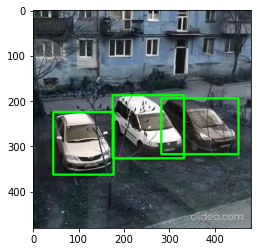

Frame:  30


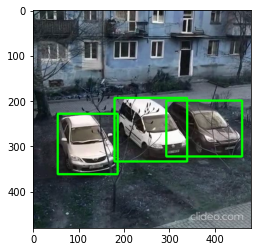

Frame:  60


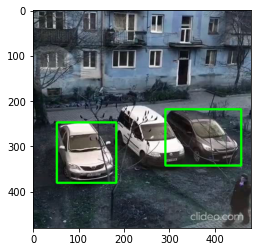

Frame:  90


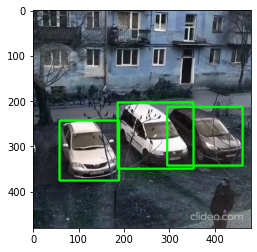

Frame:  120


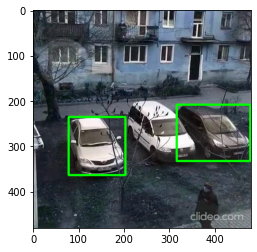

Frame:  150


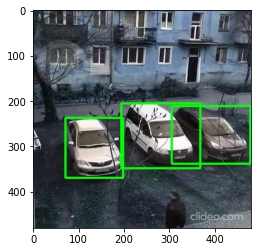

Frame:  180


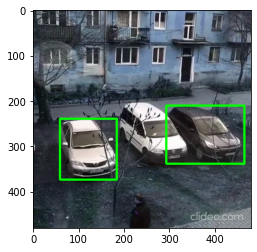

Frame:  210


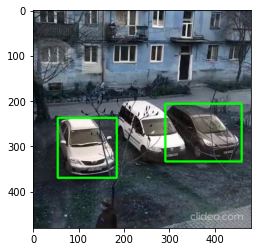

Frame:  240


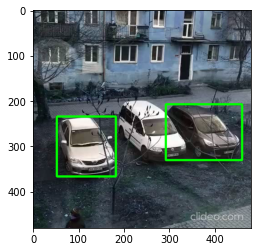

Frame:  270


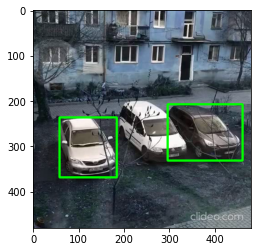

Frame:  300


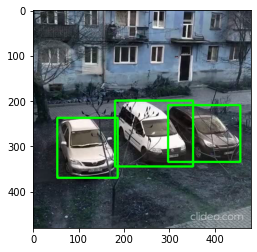

Frame:  330


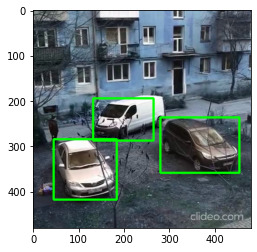

Frame:  360


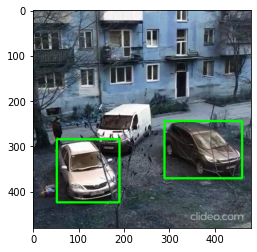

Frame:  390


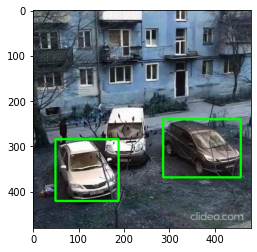

Frame:  420


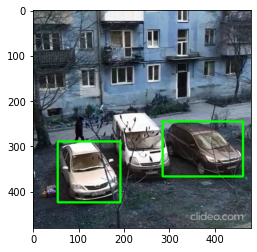

Frame:  450


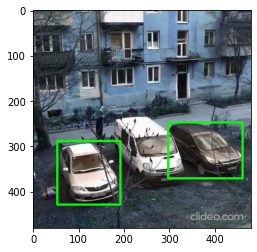

Frame:  480


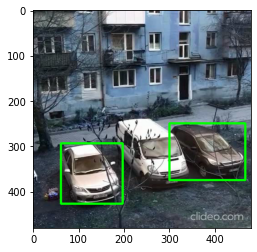

Frame:  510


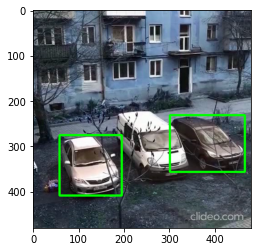

Frame:  540


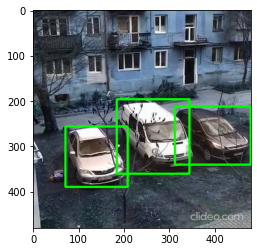

Frame:  570


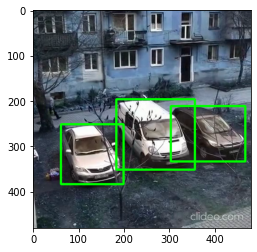

Frame:  600


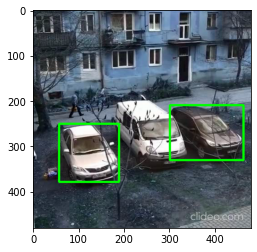

Frame:  630


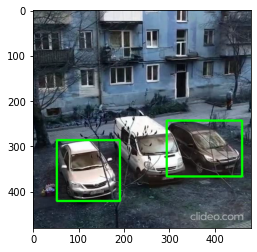

Frame:  660


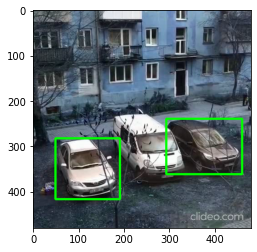

Frame:  690


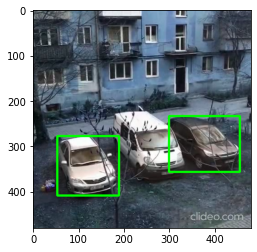

Frame:  720


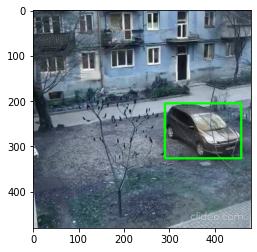

Frame:  750


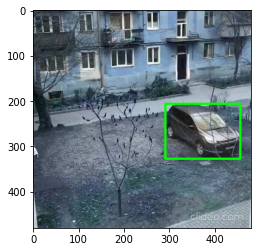

Frame:  780


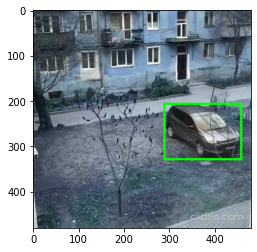

In [ ]:
import os
import numpy as np
import cv2
import mrcnn.config
import mrcnn.utils
from mrcnn.model import MaskRCNN
from pathlib import Path
import glob

# Configuration that will be used by the Mask-RCNN library
class MaskRCNNConfig(mrcnn.config.Config):
    NAME = "coco_pretrained_model_config"
    IMAGES_PER_GPU = 1
    GPU_COUNT = 1
    NUM_CLASSES = 1 + 80  # COCO dataset has 80 classes + one background class
    DETECTION_MIN_CONFIDENCE = 0.6


# Filter a list of Mask R-CNN detection results to get only the detected cars / trucks
def get_car_boxes(boxes, class_ids, scores):
    car_boxes = []

    for i, box in enumerate(boxes):
        # If the detected object isn't a car / truck, skip it
        if class_ids[i] in [3, 8, 6] and scores[i] >= 0.9:
            car_boxes.append(box)

    return np.array(car_boxes)



# Root directory of the project
ROOT_DIR = Path(".")

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")

# # Download COCO trained weights from Releases if needed
# if not os.path.exists(COCO_MODEL_PATH):
#     mrcnn.utils.download_trained_weights(COCO_MODEL_PATH)

# # Directory of images to run detection on
IMAGE_DIR = os.path.join(ROOT_DIR, "test_images")



# Create a Mask-RCNN model in inference mode
model = MaskRCNN(mode="inference", model_dir=MODEL_DIR, config=MaskRCNNConfig())

# Load pre-trained model
model.load_weights(COCO_MODEL_PATH, by_name=True)

!rm -r DetectedCars
!mkdir DetectedCars

# # Video file or camera to process - set this to 0 to use your webcam instead of a video file
VIDEO_SOURCE = "test_videos/2.mp4"
# Load the video file we want to run detection on
video_capture = cv2.VideoCapture(VIDEO_SOURCE)

#counter used to reduce the detection rate, thereby increasing performance
counter = -1

# Loop over each frame of video
while video_capture.isOpened():
    success, frame = video_capture.read()
    if not success:
        break
    counter += 1

    #count used to reduce the detection rate, thereby increasing performance
    if counter % 30 != 0:
      continue

    rgb_image = frame[:, :, ::-1]
    results = model.detect([rgb_image], verbose=0)
    r = results[0]

    car_boxes = get_car_boxes(r['rois'], r['class_ids'], r['scores'])

    # Loop through each car_boxes
    for parking_area in car_boxes:
        # Get the top-left and bottom-right coordinates of the car box
        y1, x1, y2, x2 = parking_area
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 3)
    print('Frame: ', counter)
    pt.pyplot.imshow(frame)
    pt.pyplot.show()
    # #saving each frame
    name = str(counter) + ".jpg"
    name = os.path.join('./DetectedCars', name)
    cv2.imwrite(name, frame)

# Clean up everything when finished
video_capture.release()
cv2.destroyAllWindows()

[{'rois': array([[ 506,  513,  597,  647],
       [ 489,  189,  605,  361],
       [ 496, 1311,  616, 1434],
       [ 292, 1670,  394, 1796],
       [ 495,    1,  578,   83],
       [ 748, 1631,  950, 1884],
       [ 698,    6,  907,  197],
       [ 507, 1783,  642, 1920],
       [ 910,  155, 1072,  496],
       [ 479,  348,  598,  513],
       [ 702,  136,  929,  413],
       [ 505,  964,  625, 1087],
       [ 737,  347,  950,  623],
       [ 718,  625,  951,  857],
       [ 375,  494,  435,  632],
       [ 354, 1555,  434, 1666],
       [ 947, 1183, 1074, 1440],
       [ 459,   31,  599,  269],
       [ 466, 1429,  550, 1529],
       [ 453,  868,  536,  973],
       [ 369, 1367,  431, 1447],
       [ 451,  222,  505,  347],
       [ 359,  738,  418,  825],
       [ 270, 1617,  347, 1710],
       [ 674, 1846,  885, 1920],
       [ 496, 1164,  616, 1274],
       [ 358,  315,  432,  428],
       [ 341,  426,  388,  511],
       [ 751, 1177,  945, 1367],
       [ 369, 1146,  437, 1223],


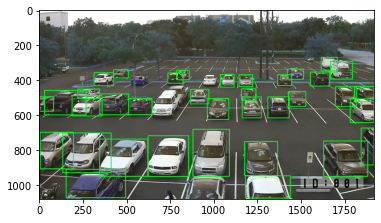

True

In [ ]:
import os
import numpy as np
import cv2
import mrcnn.config
import mrcnn.utils
from mrcnn.model import MaskRCNN
from pathlib import Path
import glob

# Configuration that will be used by the Mask-RCNN library
class MaskRCNNConfig(mrcnn.config.Config):
    NAME = "coco_pretrained_model_config"
    IMAGES_PER_GPU = 1
    GPU_COUNT = 1
    NUM_CLASSES = 1 + 80  # COCO dataset has 80 classes + one background class
    DETECTION_MIN_CONFIDENCE = 0.6


# Filter a list of Mask R-CNN detection results to get only the detected cars / trucks
def get_car_boxes(boxes, class_ids):
    car_boxes = []

    for i, box in enumerate(boxes):
        # If the detected object isn't a car / truck, skip it
        if class_ids[i] in [3, 8, 6]:
            car_boxes.append(box)

    return np.array(car_boxes)

# Root directory of the project
ROOT_DIR = Path(".")

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")

# Create a Mask-RCNN model in inference mode
model = MaskRCNN(mode="inference", model_dir=MODEL_DIR, config=MaskRCNNConfig())

# Load pre-trained model
model.load_weights(COCO_MODEL_PATH, by_name=True)

img = cv2.imread('test_images/test.png') 
rgb_image = img[:, :, ::-1]
results = model.detect([rgb_image], verbose=0)
print(results)
r=results[0]
parked_car_boxes = get_car_boxes(r['rois'], r['class_ids'])
for y1, x1, y2, x2 in parked_car_boxes:
  cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 30), 3)
print('Full Parking Lot')
pt.pyplot.imshow(img)
pt.pyplot.show()
# #saving each frame
name = "parked_car_boxes.jpg"
name = os.path.join('./DetectedCars', name)
cv2.imwrite(name, img)

### **VIDEO PROCESSING**

rm: cannot remove 'Josh': No such file or directory
Full Parking Lot


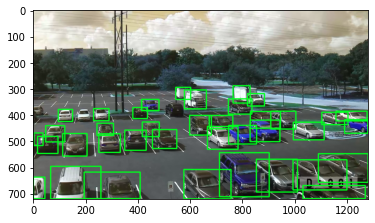

Frame:  10


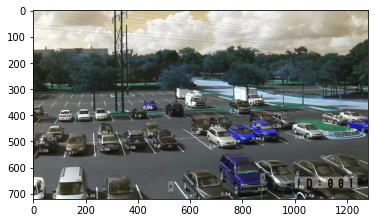

Frame:  20


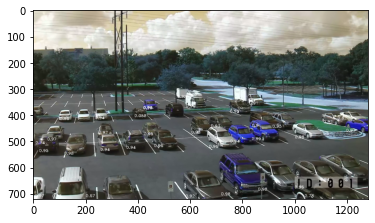

Frame:  30


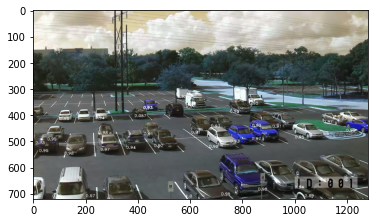

Frame:  40


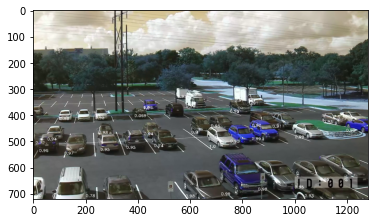

Frame:  50


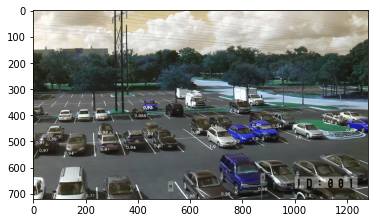

Frame:  60


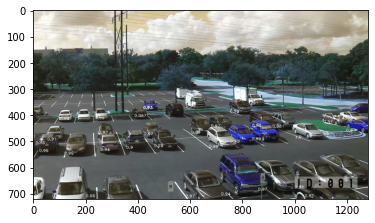

Frame:  70


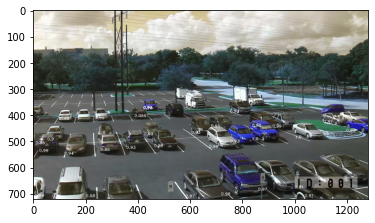

Frame:  80


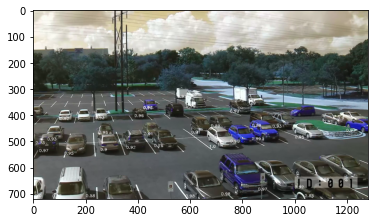

Frame:  90


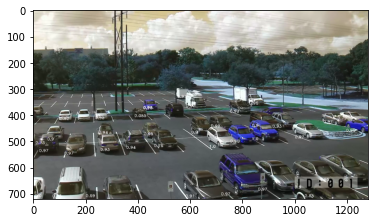

Frame:  100


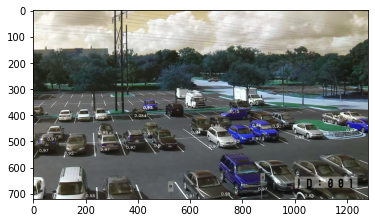

Frame:  110


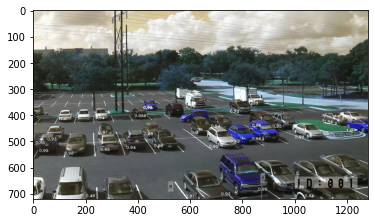

Frame:  120


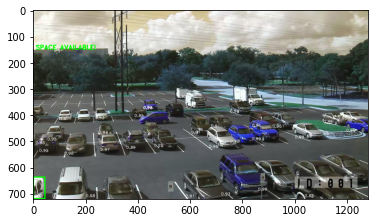

Frame:  130


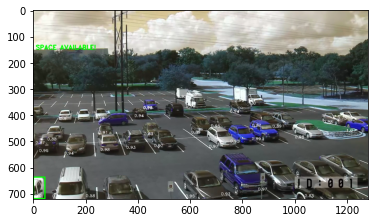

Frame:  140


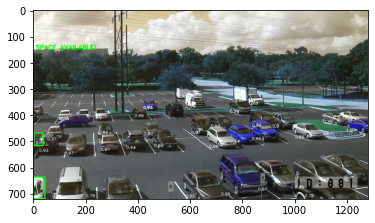

Frame:  150


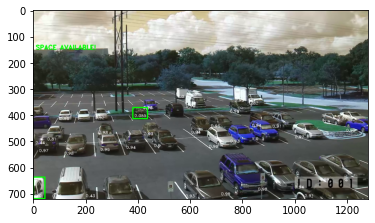

Frame:  160


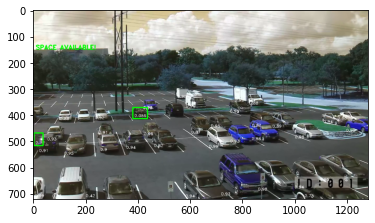

Frame:  170


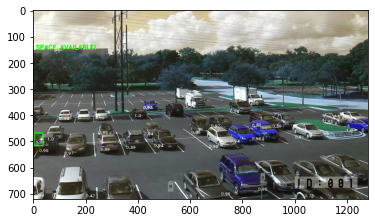

Frame:  180


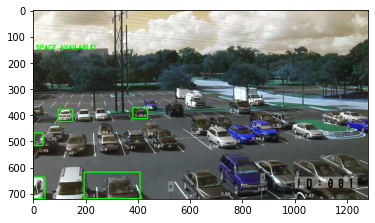

Frame:  190


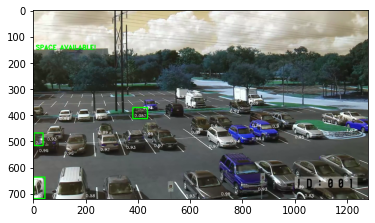

Frame:  200


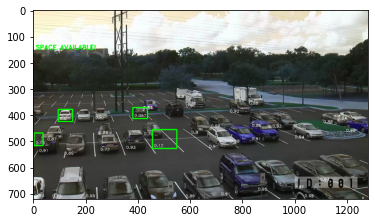

Frame:  210


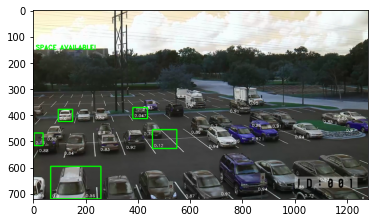

Frame:  220


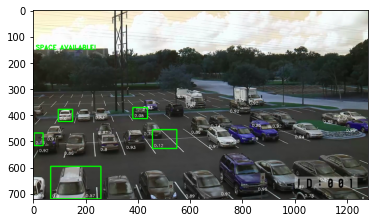

Frame:  230


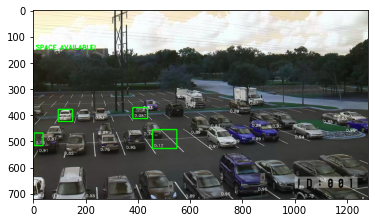

Frame:  240


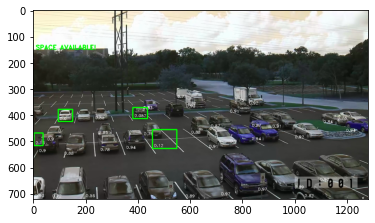

Frame:  250


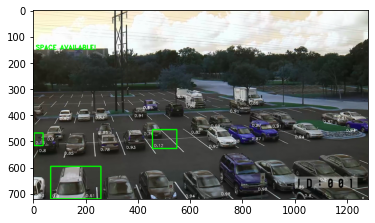

Frame:  260


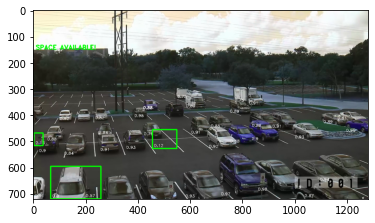

Frame:  270


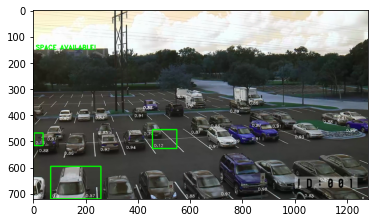

Frame:  280


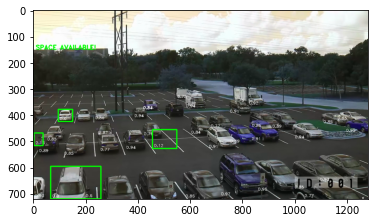

Frame:  290


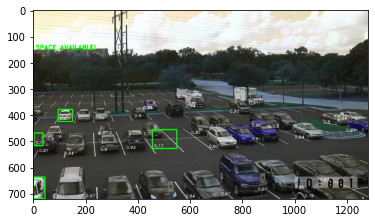

Frame:  300


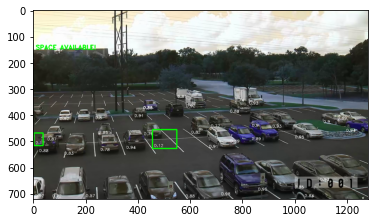

Frame:  310


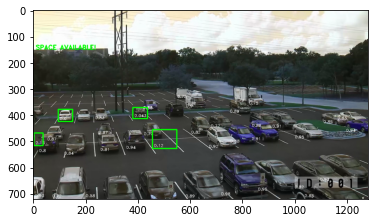

Frame:  320


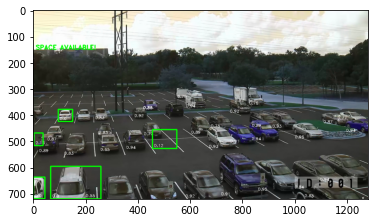

Frame:  330


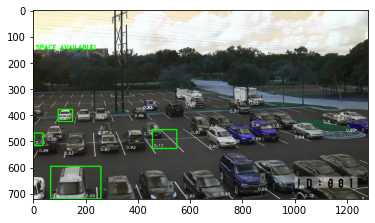

Frame:  340


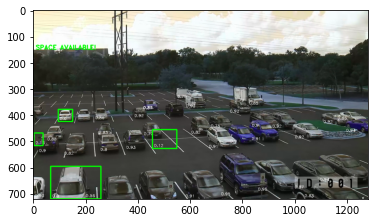

Frame:  350


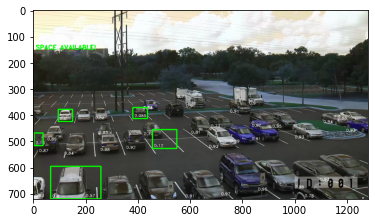

Frame:  360


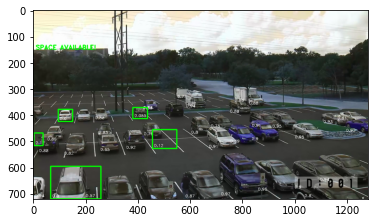

Frame:  370


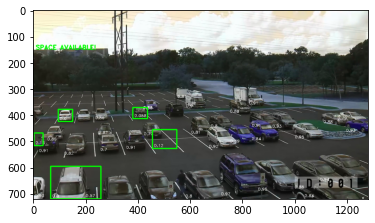

Frame:  380


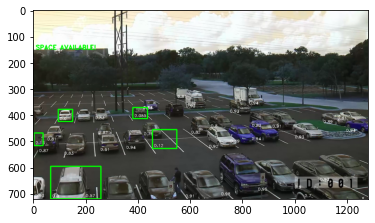

Frame:  390


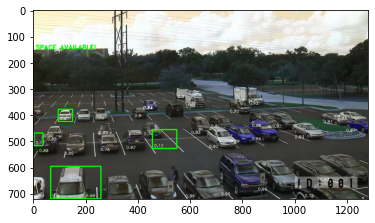

Frame:  400


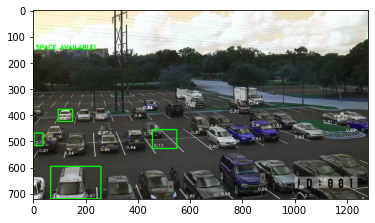

Frame:  410


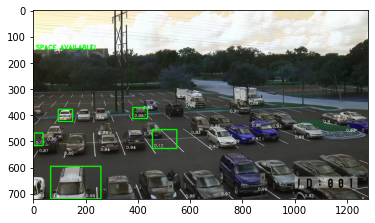

Frame:  420


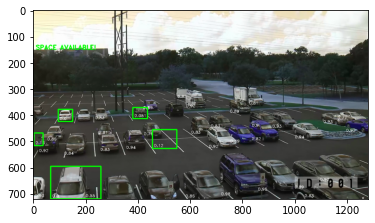

Frame:  430


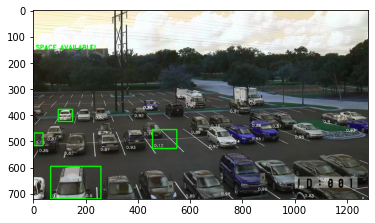

Frame:  440


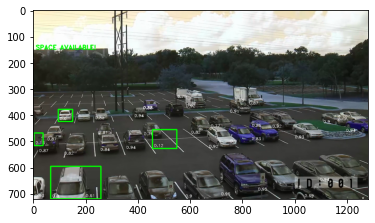

Frame:  450


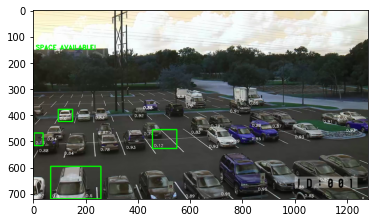

Frame:  460


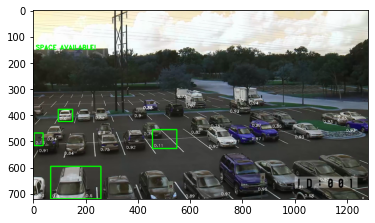

Frame:  470


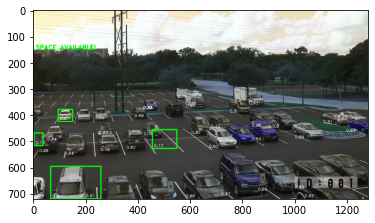

Frame:  480


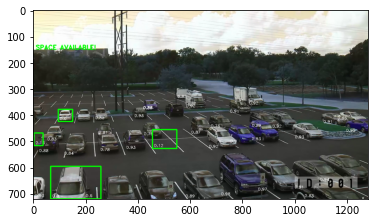

Frame:  490


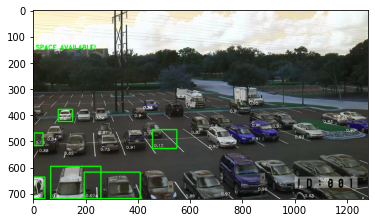

Frame:  500


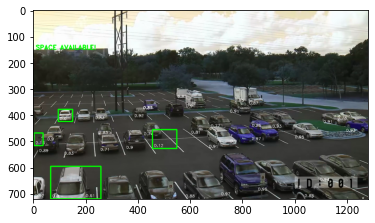

Frame:  510


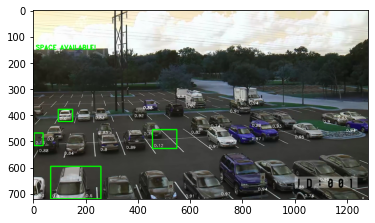

Frame:  520


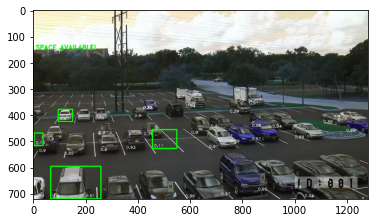

Frame:  530


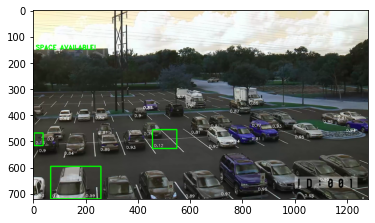

Frame:  540


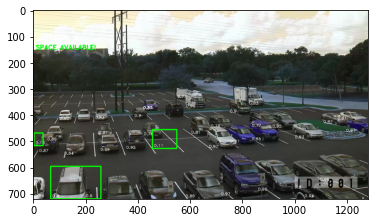

Frame:  550


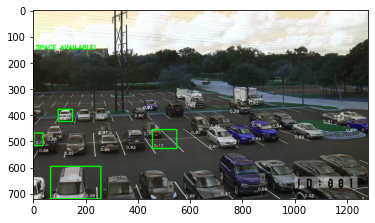

Frame:  560


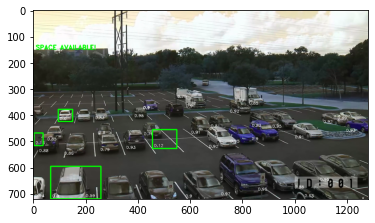

Frame:  570


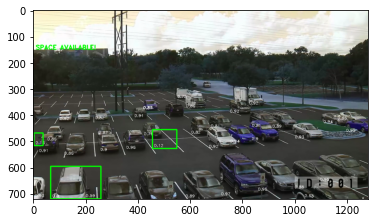

Frame:  580


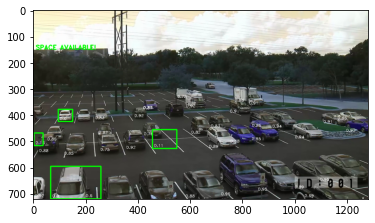

Frame:  590


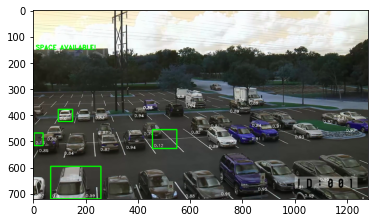

Frame:  600


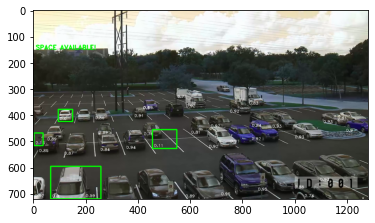

Frame:  610


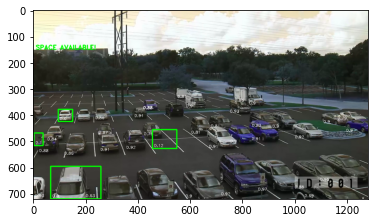

Frame:  620


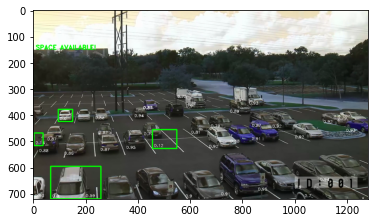

Frame:  630


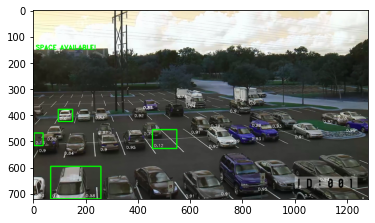

Frame:  640


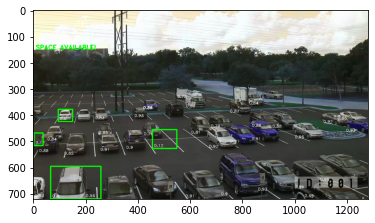

Frame:  650


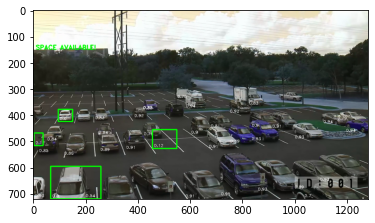

Frame:  660


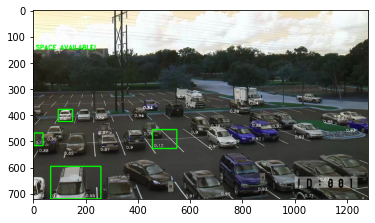

Frame:  670


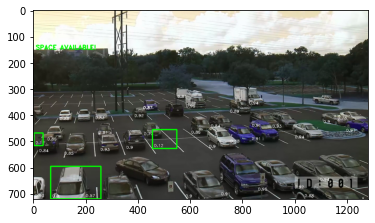

Frame:  680


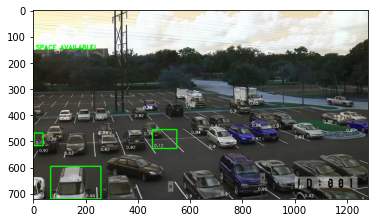

Frame:  690


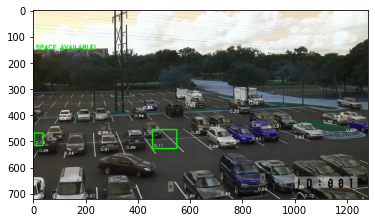

Frame:  700


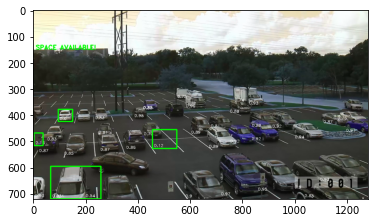

Frame:  710


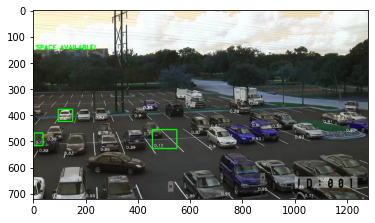

Frame:  720


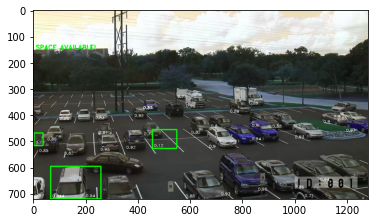

Frame:  730


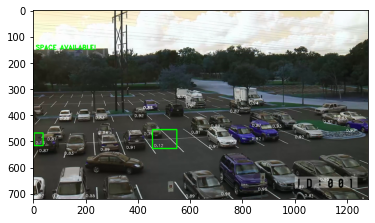

Frame:  740


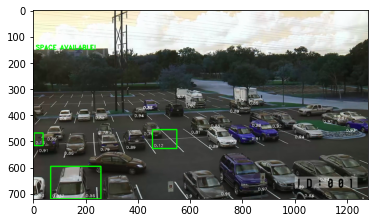

Frame:  750


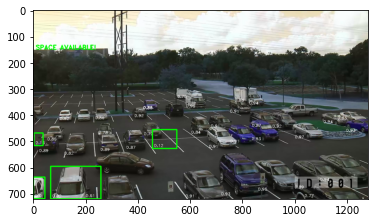

Frame:  760


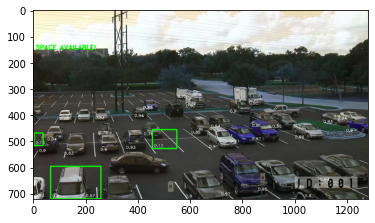

Frame:  770


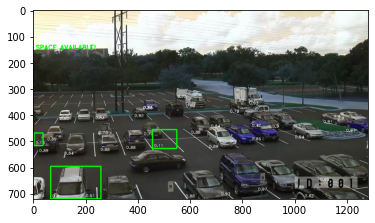

Frame:  780


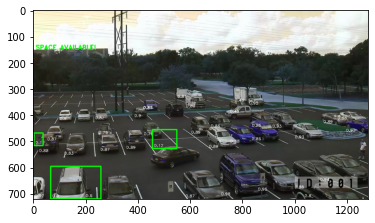

Frame:  790


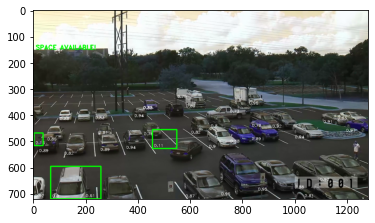

Frame:  800


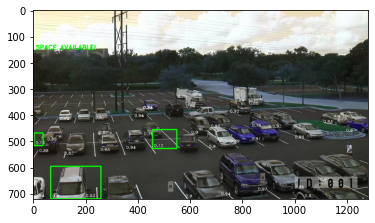

Frame:  810


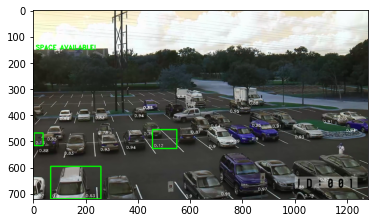

Frame:  820


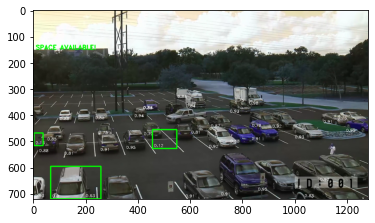

Frame:  830


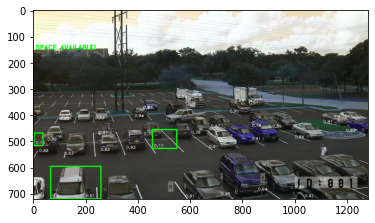

Frame:  840


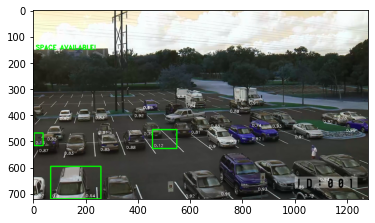

Frame:  850


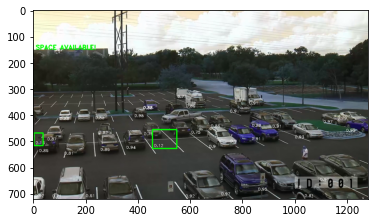

Frame:  860


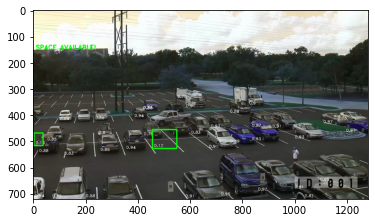

Frame:  870


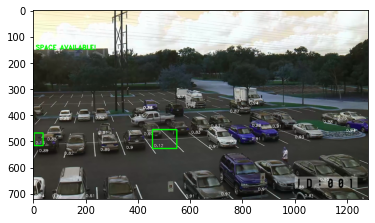

Frame:  880


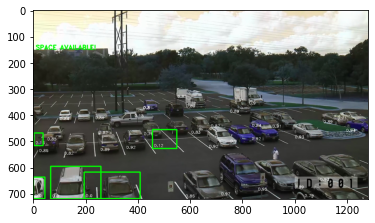

Frame:  890


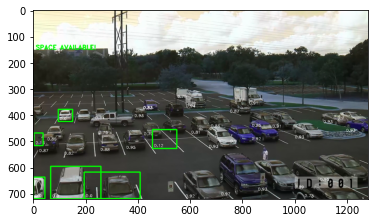

Frame:  900


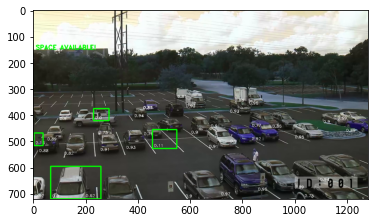

Frame:  910


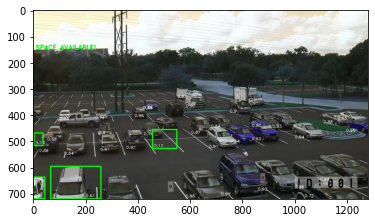

Frame:  920


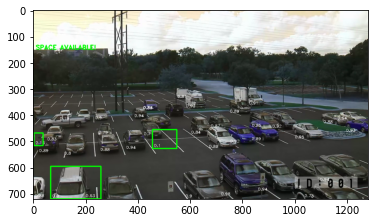

Frame:  930


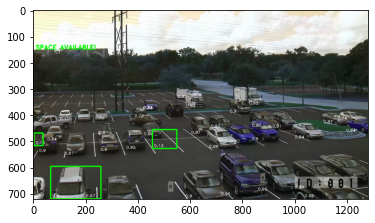

Frame:  940


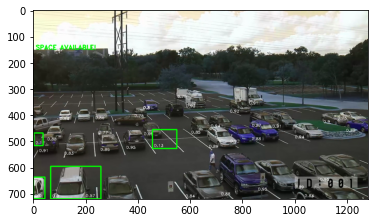

Frame:  950


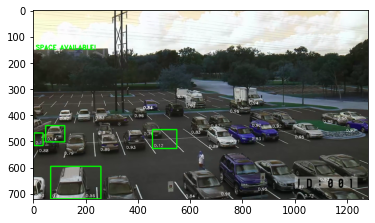

Frame:  960


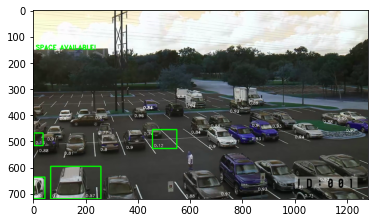

Frame:  970


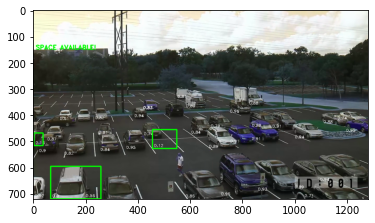

Frame:  980


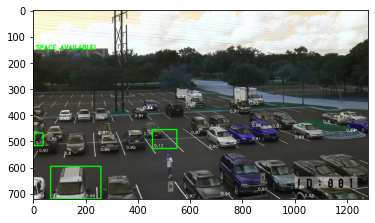

Frame:  990


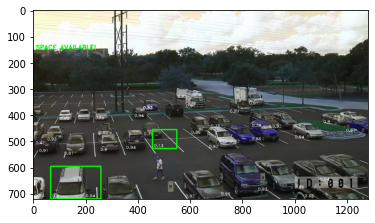

Frame:  1000


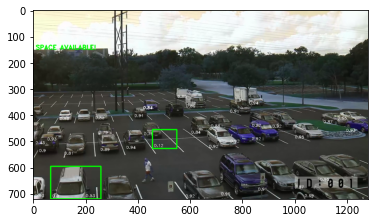

Frame:  1010


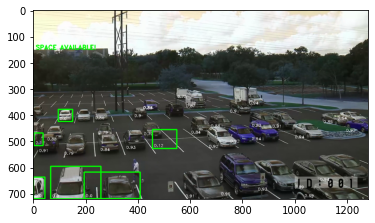

Frame:  1020


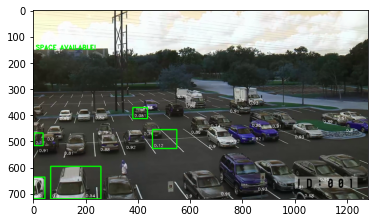

Frame:  1030


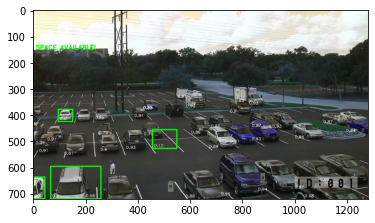

Frame:  1040


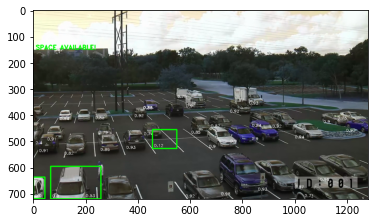

Frame:  1050


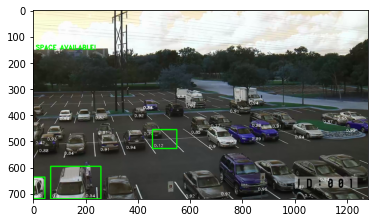

Frame:  1060


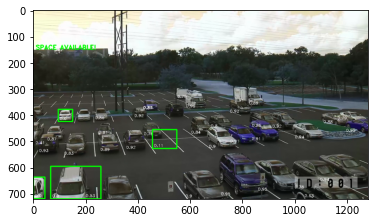

Frame:  1070


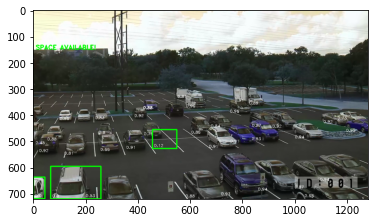

Frame:  1080


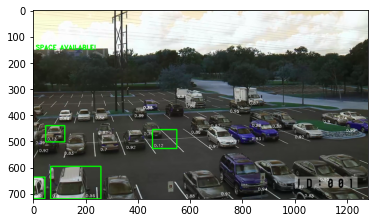

Frame:  1090


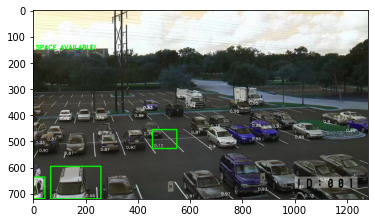

Frame:  1100


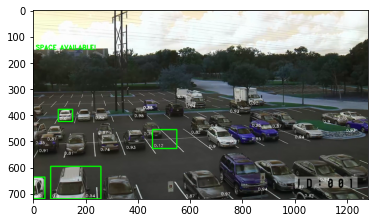

Frame:  1110


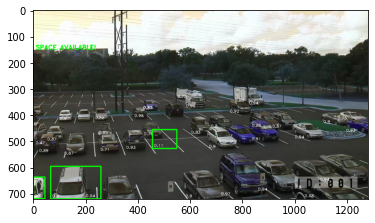

Frame:  1120


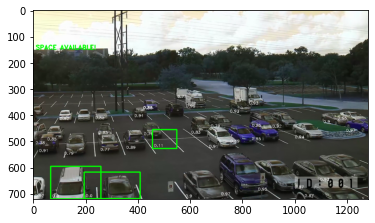

Frame:  1130


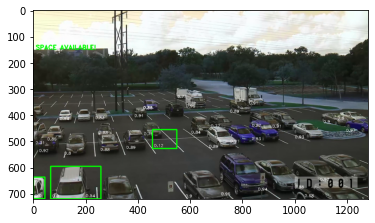

Frame:  1140


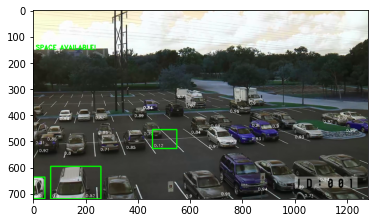

Frame:  1150


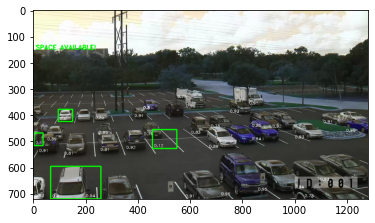

Frame:  1160


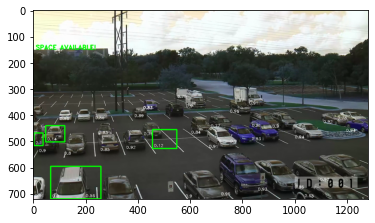

Frame:  1170


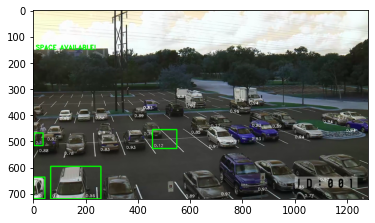

Frame:  1180


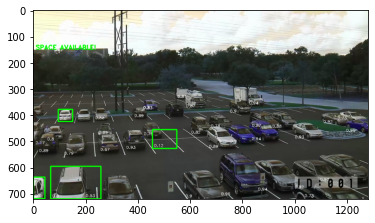

Frame:  1190


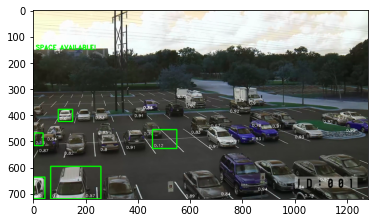

Frame:  1200


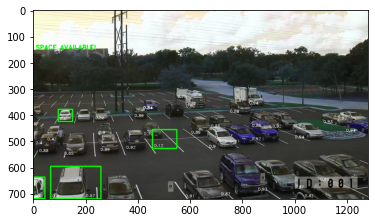

Frame:  1210


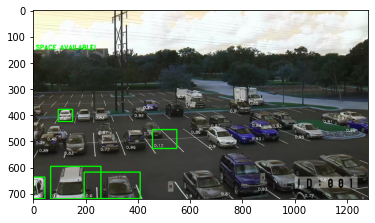

Frame:  1220


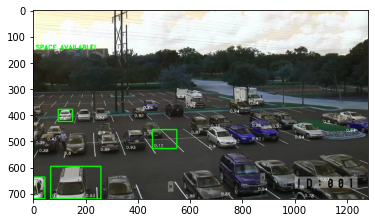

Frame:  1230


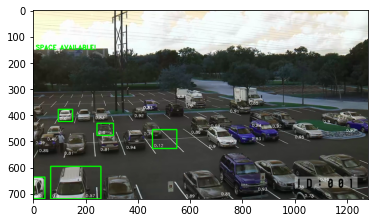

Frame:  1240


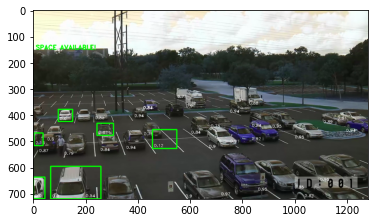

Frame:  1250


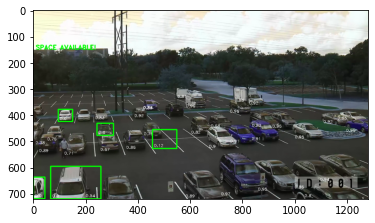

Frame:  1260


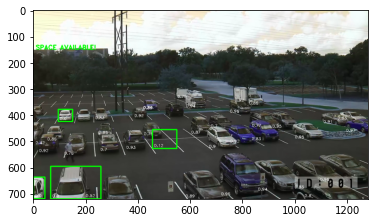

Frame:  1270


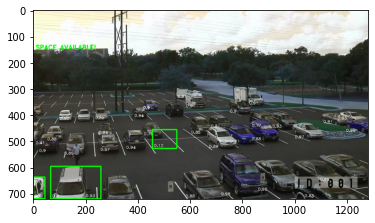

Frame:  1280


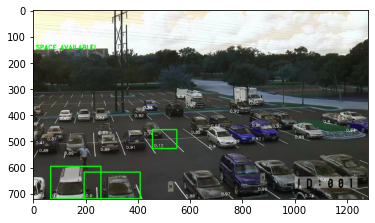

Frame:  1290


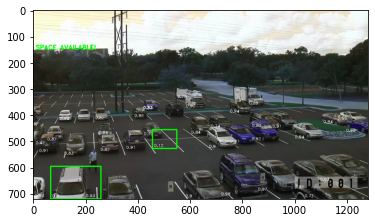

Frame:  1300


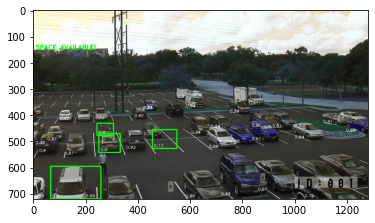

Frame:  1310


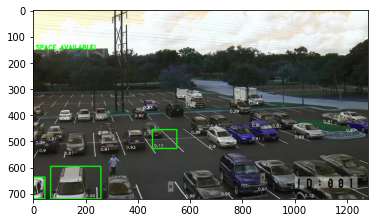

Frame:  1320


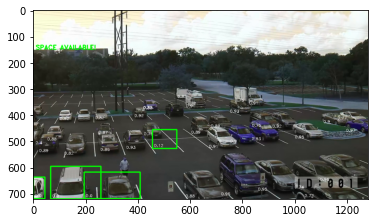

Frame:  1330


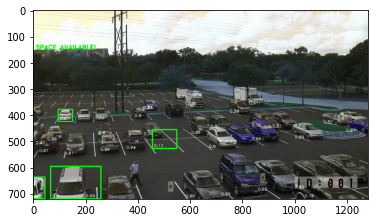

Frame:  1340


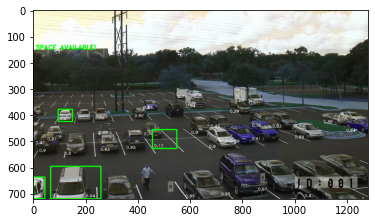

Frame:  1350


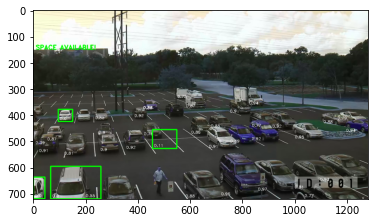

Frame:  1360


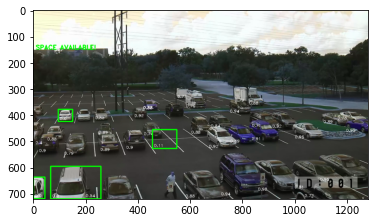

Frame:  1370


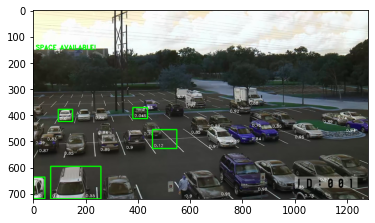

Frame:  1380


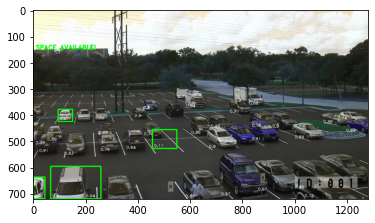

Frame:  1390


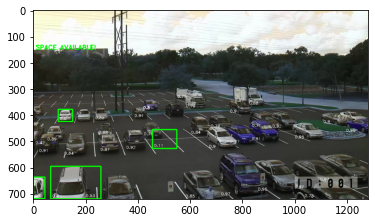

Frame:  1400


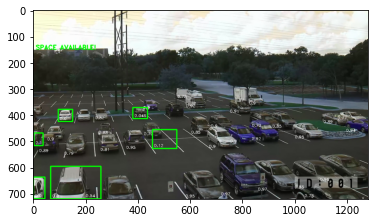

Frame:  1410


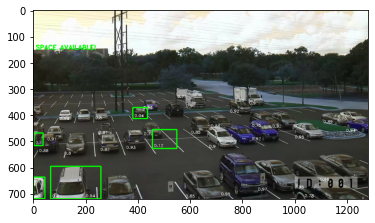

Frame:  1420


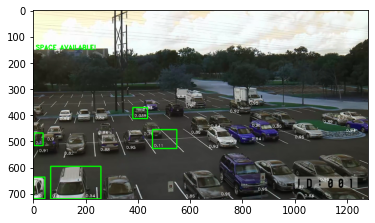

Frame:  1430


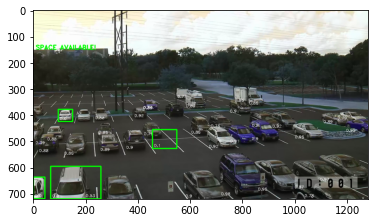

Frame:  1440


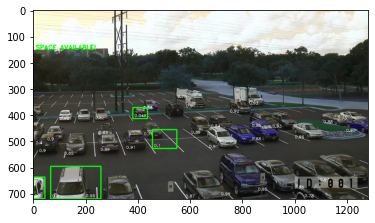

Frame:  1450


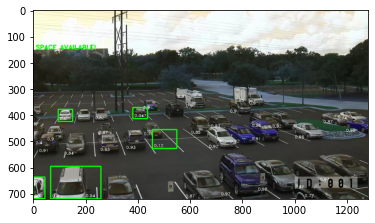

Frame:  1460


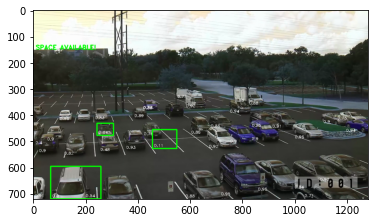

In [ ]:
import os
import numpy as np
import cv2
import mrcnn.config
import mrcnn.utils
from mrcnn.model import MaskRCNN
from pathlib import Path
import glob

# Configuration that will be used by the Mask-RCNN library
class MaskRCNNConfig(mrcnn.config.Config):
    NAME = "coco_pretrained_model_config"
    IMAGES_PER_GPU = 1
    GPU_COUNT = 1
    NUM_CLASSES = 1 + 80  # COCO dataset has 80 classes + one background class
    DETECTION_MIN_CONFIDENCE = 0.6


# Filter a list of Mask R-CNN detection results to get only the detected cars / trucks
# def get_car_boxes(boxes, class_ids, scores):
#     car_boxes = []

#     for i, box in enumerate(boxes):
#         # If the detected object isn't a car / truck, skip it
#         if class_ids[i] in [3, 8, 6] and scores[i] >= 0.9:
#             car_boxes.append(box)

#     return np.array(car_boxes)

def get_car_boxes(boxes, class_ids):
    car_boxes = []

    for i, box in enumerate(boxes):
        # If the detected object isn't a car / truck, skip it
        if class_ids[i] in [3, 8, 6]:
            car_boxes.append(box)

    return np.array(car_boxes)


# Root directory of the project
ROOT_DIR = Path(".")

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")

# # Download COCO trained weights from Releases if needed
# if not os.path.exists(COCO_MODEL_PATH):
#     mrcnn.utils.download_trained_weights(COCO_MODEL_PATH)

# # Directory of images to run detection on
IMAGE_DIR = os.path.join(ROOT_DIR, "test_images")



# Create a Mask-RCNN model in inference mode
model = MaskRCNN(mode="inference", model_dir=MODEL_DIR, config=MaskRCNNConfig())

# Load pre-trained model
model.load_weights(COCO_MODEL_PATH, by_name=True)

!rm -r Josh
!mkdir Josh

# # Video file or camera to process - set this to 0 to use your webcam instead of a video file
VIDEO_SOURCE = "test_videos/3.mp4"
# Load the video file we want to run detection on
video_capture = cv2.VideoCapture(VIDEO_SOURCE)


# FULL PARKING LOT IMAGE
# This is the first frame of video - assume all the cars detected are in parking spaces.
# Save the location of each car as a parking space box and go to the next frame of video.
# img = cv2.imread('test_images/1_full.png') 
# rgb_image = img[:, :, ::-1]
# results = model.detect([rgb_image], verbose=0)
# # print(results)
# r=results[0]
parked_car_boxes = None #get_car_boxes(r['rois'], r['class_ids'])
# for y1, x1, y2, x2 in parked_car_boxes:
#   cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 30), 3)
# print('Full Parking Lot')
# pt.pyplot.imshow(img)
# pt.pyplot.show()

#counter used to reduce the detection rate, thereby increasing performance
counter = -1

free_space_frames = 0
# Loop over each frame of video
while video_capture.isOpened():
    success, frame = video_capture.read()
    if not success:
        break
    counter += 1
#count used to reduce the detection rate, thereby increasing performance
    if counter % 10 != 0:
      continue

    # Convert the image from BGR color (which OpenCV uses) to RGB color
    rgb_image = frame[:, :, ::-1]

    # Run the image through the Mask R-CNN model to get results.
    results = model.detect([rgb_image], verbose=0)

    # Mask R-CNN assumes we are running detection on multiple images.
    # We only passed in one image to detect, so only grab the first result.
    r = results[0]

    # The r variable will now have the results of detection:
    # - r['rois'] are the bounding box of each detected object
    # - r['class_ids'] are the class id (type) of each detected object
    # - r['scores'] are the confidence scores for each detection
    # - r['masks'] are the object masks for each detected object (which gives you the object outline)

    if parked_car_boxes is None:
        # This is the first frame of video - assume all the cars detected are in parking spaces.
        # Save the location of each car as a parking space box and go to the next frame of video.
        # parked_car_boxes = get_car_boxes(r['rois'], r['class_ids'], r['scores'])
        parked_car_boxes = get_car_boxes(r['rois'], r['class_ids'])
        if len(parked_car_boxes)!=0:
          for y1, x1, y2, x2 in parked_car_boxes:
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 30), 3)
          print('Full Parking Lot')
          pt.pyplot.imshow(frame)
          pt.pyplot.show()
        else:  
          parked_car_boxes = None
    else:
        # We already know where the parking spaces are. Check if any are currently unoccupied.
        # Get where cars are currently located in the frame
        # car_boxes = get_car_boxes(r['rois'], r['class_ids'], r['scores'])
        car_boxes = get_car_boxes(r['rois'], r['class_ids'])

        # See how much those cars overlap with the known parking spaces
        overlaps = mrcnn.utils.compute_overlaps(parked_car_boxes, car_boxes)

        # Assume no spaces are free until we find one that is free
        free_space = False
        free_space_boxes = []

        # Loop through each known parking space box
        for parking_area, overlap_areas in zip(parked_car_boxes, overlaps):

            # For this parking space, find the max amount it was covered by any
            # car that was detected in our image (doesn't really matter which car)
            max_IoU_overlap = np.max(overlap_areas)

            # Get the top-left and bottom-right coordinates of the parking area
            y1, x1, y2, x2 = parking_area

            # Check if the parking space is occupied by seeing if any car overlaps
            # it by more than 0.15 using IoU
            if max_IoU_overlap < 0.15:
                # Parking space not occupied! Draw a green box around it
                # cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 3)
                # Flag that we have seen at least one open space
                free_space = True
                free_space_boxes.append([y1, x1, y2, x2])
            # else:
            #     # Parking space is still occupied - draw a red box around it
            #     cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 0, 255), 3)

            # Write the IoU measurement inside the box
            font = cv2.FONT_HERSHEY_DUPLEX
            cv2.putText(frame, f"{max_IoU_overlap:0.2}", (x1 + 6, y2 - 6), font, 0.5, (255, 255, 255))

        # If at least one space was free, start counting frames
        # This is so we don't alert based on one frame of a spot being open.
        # This helps prevent the script triggered on one bad detection.
        if free_space:
            free_space_frames += 1
        else:
            # If no spots are free, reset the count
            free_space_frames = 0
            free_space_boxes = []

        # If a space has been free for several frames, we are pretty sure it is really free!
        if free_space_frames > 10:
            # Write SPACE AVAILABLE!! at the top of the screen
            font = cv2.FONT_HERSHEY_DUPLEX
            cv2.putText(frame, f"SPACE AVAILABLE!", (10, 150), font, 0.8, (0, 255, 0), 2, cv2.FILLED)
            
            #perform other actions
            # Parking space not occupied! Draw a green box around all free parking spaces
            #ability to count the free slots len(free_space_boxes)
            for y1, x1, y2, x2 in free_space_boxes:
              cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 3)

        # Show the frame of video on the screen
        print('Frame: ', counter)
        pt.pyplot.imshow(frame)
        pt.pyplot.show()
    # #saving each frame
    name = str(counter) + ".jpg"
    name = os.path.join('./Josh', name)
    cv2.imwrite(name, frame)

    # Hit 'q' to quit
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Clean up everything when finished
video_capture.release()
cv2.destroyAllWindows()

### Convert Videos to Image Frames

In [ ]:
import cv2

def Video_to_Images(video_src, image_dir):
  counter = 0
  video_capture = cv2.VideoCapture(video_src)
  while video_capture.isOpened():
    success, frame = video_capture.read()
    if not success:
        break
    name = str(counter) + ".jpg"
    name = os.path.join(image_dir, name)
    cv2.imwrite(name, frame)
  print('Process Complete')


['./test_images/full.png', './test_images/1.png', './test_images/2.png']

### **VERSION 1**








Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Instructions for updating:
box_ind is deprecated, use box_indices instead


Instructions for updating:
Use `tf.cast` instead.






None parked_car_boxes;  going in to mark vehicles. Frame number:   10
car_boxes [[187 182 326 334]
 [193 288 318 455]]


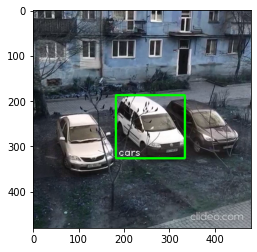

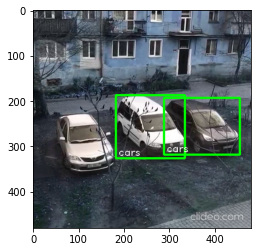

counter % 50 == 0;  going in to mark vehicles. Frame number:   100
car_boxes [[187 182 326 334]
 [193 288 318 455]]


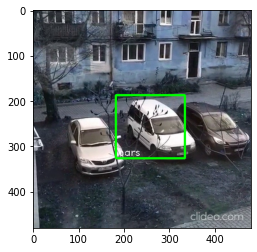

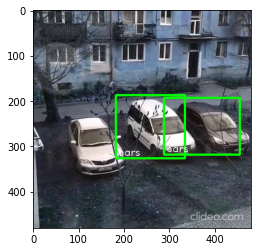

max_IoU_overlap 1.0
max_IoU_overlap 1.0
counter % 50 == 0;  going in to mark vehicles. Frame number:   200
car_boxes [[187 182 326 334]
 [193 288 318 455]]


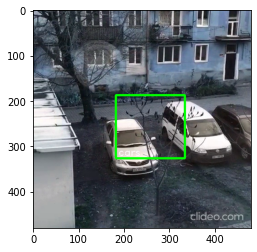

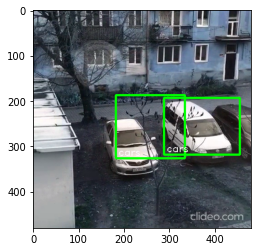

max_IoU_overlap 1.0
max_IoU_overlap 1.0
counter % 50 == 0;  going in to mark vehicles. Frame number:   300
car_boxes [[187 182 326 334]
 [193 288 318 455]]


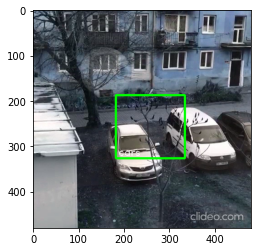

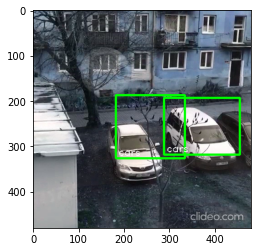

max_IoU_overlap 1.0
max_IoU_overlap 1.0
counter % 50 == 0;  going in to mark vehicles. Frame number:   400
car_boxes [[187 182 326 334]
 [193 288 318 455]]


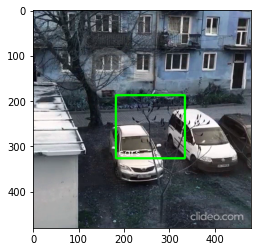

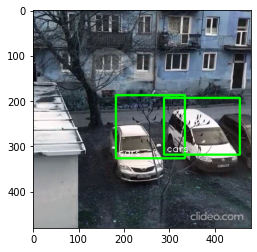

max_IoU_overlap 1.0
max_IoU_overlap 1.0
counter % 50 == 0;  going in to mark vehicles. Frame number:   500
car_boxes [[187 182 326 334]
 [193 288 318 455]]


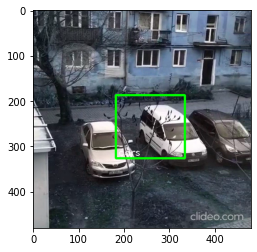

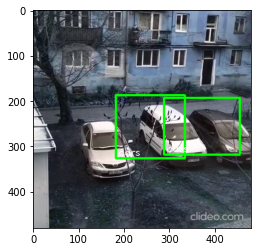

max_IoU_overlap 1.0
max_IoU_overlap 1.0
counter % 50 == 0;  going in to mark vehicles. Frame number:   600
car_boxes [[187 182 326 334]
 [193 288 318 455]]


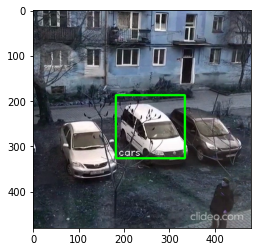

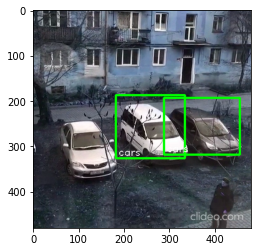

max_IoU_overlap 1.0
max_IoU_overlap 1.0
counter % 50 == 0;  going in to mark vehicles. Frame number:   700
car_boxes [[187 182 326 334]
 [193 288 318 455]]


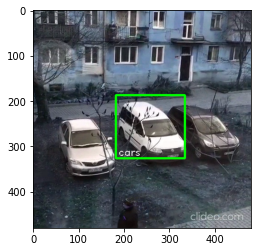

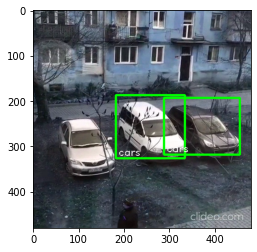

max_IoU_overlap 1.0
max_IoU_overlap 1.0
counter % 50 == 0;  going in to mark vehicles. Frame number:   800
car_boxes [[187 182 326 334]
 [193 288 318 455]]


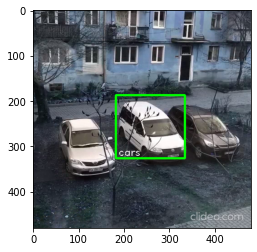

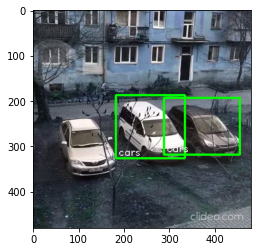

max_IoU_overlap 1.0
max_IoU_overlap 1.0
counter % 50 == 0;  going in to mark vehicles. Frame number:   900
car_boxes [[187 182 326 334]
 [193 288 318 455]]


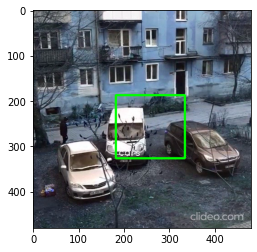

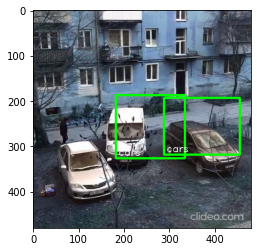

max_IoU_overlap 1.0
max_IoU_overlap 1.0
counter % 50 == 0;  going in to mark vehicles. Frame number:   1000
car_boxes [[187 182 326 334]
 [193 288 318 455]]


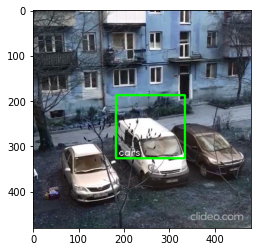

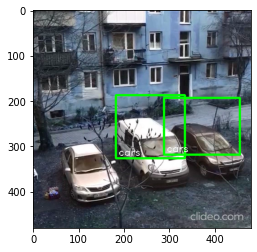

max_IoU_overlap 1.0
max_IoU_overlap 1.0
counter % 50 == 0;  going in to mark vehicles. Frame number:   1100
car_boxes [[187 182 326 334]
 [193 288 318 455]]


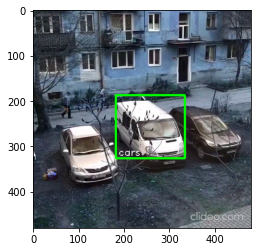

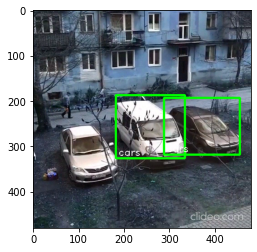

max_IoU_overlap 1.0
max_IoU_overlap 1.0
counter % 50 == 0;  going in to mark vehicles. Frame number:   1200
car_boxes [[187 182 326 334]
 [193 288 318 455]]


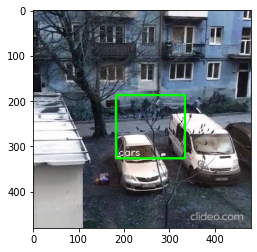

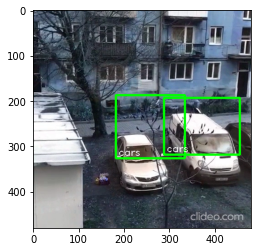

max_IoU_overlap 1.0
max_IoU_overlap 1.0
counter % 50 == 0;  going in to mark vehicles. Frame number:   1300
car_boxes [[187 182 326 334]
 [193 288 318 455]]


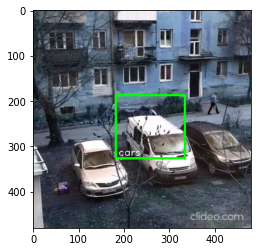

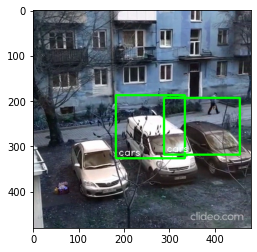

max_IoU_overlap 1.0
max_IoU_overlap 1.0
counter % 50 == 0;  going in to mark vehicles. Frame number:   1400
car_boxes [[187 182 326 334]
 [193 288 318 455]]


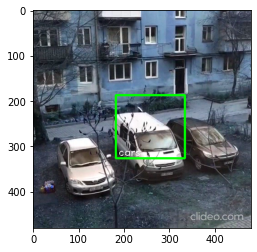

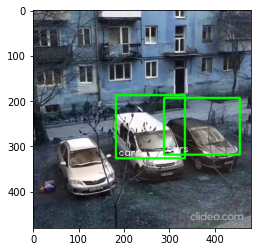

max_IoU_overlap 1.0
max_IoU_overlap 1.0
No frame to process
Video finished


In [ ]:
!rm -r Josh
!mkdir Josh


ROOT_DIR = Path('.')
MODEL_DIR = os.path.join(ROOT_DIR, "logs")
coco_model_path = os.path.join(ROOT_DIR, 'mask_rcnn_coco.h5')

model = MaskRCNN(mode='inference', model_dir=MODEL_DIR, config=MaskRCNNConfig())
model.load_weights(coco_model_path, by_name=True)


Video_source = "test_videos/7.mp4"


video_capture = cv2.VideoCapture(Video_source)
parked_car_boxes = None
car_boxes = None
free_space = False
counter = 0

# Filter to only cars
def get_car_boxes(boxes, class_ids):
    car_boxes = []

    for i, box in enumerate(boxes):
        if class_ids[i] in [3, 8, 6]:
            car_boxes.append(box)

    return np.array(car_boxes)

def show_detected_cars(car_boxes):
  print('car_boxes', car_boxes)
  for cars in car_boxes:
    y1, x1, y2, x2 = cars
    cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 3)

    # Write the IoU measurement inside the box
    font = cv2.FONT_HERSHEY_DUPLEX
    cv2.putText(frame, "cars", (x1 + 6, y2 - 6), font, 0.7, (255, 255, 255))
    pt.pyplot.imshow(frame)
    pt.pyplot.show()




#our main loop
while video_capture.isOpened():
  success, frame = video_capture.read()

  if not success:
    print('No frame to process')
    break

  elif counter < 10:
    #create another video reader object to compare the two frames and verify the possibility of motion
    success, frame2 = video_capture.read()
    d = cv2.absdiff(frame, frame2)  
    grey = cv2.cvtColor(d, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(grey, (1, 1), 0)
    ret, th = cv2.threshold( blur, 20, 255, cv2.THRESH_BINARY)
    
    #perform these morphological transformations to erode the car which is moving so that it is not detected by MASKRCNN. Take the eorsion levels to be high. 
    dilated = cv2.dilate(th, np.ones((10, 10), np.uint8), iterations=1 )
    eroded = cv2.erode(dilated, np.ones((10, 10), np.uint8), iterations=1 )
      
    #fill the contours for even a better morphing of the vehicle
    c, h = cv2.findContours(eroded, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    frame2 = cv2.drawContours(frame2, c, -1, (0,0,0), cv2.FILLED)

    # if counter % 20 == 0:
    #   print("Current frame counter" + str(counter))
    #   pt.pyplot.imshow(frame2)
    #   pt.pyplot.show()
      
    counter = counter + 1
    continue
  
    # Converting the image from BGR color used by OpenCV to RGB color. 
  rgb_image = frame2[:,:,::-1]


    # The r variable will now have the results of detection:
  # - r['rois'] are the bounding box of each detected object
  # - r['class_ids'] are the class id (type) of each detected object
  # - r['scores'] are the confidence scores for each detection
  # - r['masks'] are the object masks for each detected object (which gives you the object outline)

  if parked_car_boxes is None:
      print("None parked_car_boxes;  going in to mark vehicles. Frame number:  ", counter)
      # video_capture = cv2.VideoCapture(VIDEO_SOURCE)
      # This is the first frame of video - assume all the cars detected are in parking spaces.
      # Save the locat ion of each car as a parking space box and go to the next frame of video.
      results = model.detect([rgb_image], verbose=0)
      # print('results',results)
      # Mask R-CNN assumes we are running detection on multiple images.
      # We only passed in one image to detect, so only grab the first result.
      r = results[0]
      parked_car_boxes = get_car_boxes(r['rois'], r['class_ids'])
      show_detected_cars(parked_car_boxes)
        
  elif counter % 100 == 0 and len(parked_car_boxes) != 0:
      print("counter % 50 == 0;  going in to mark vehicles. Frame number:  ", counter)
      #we do this because mrcnn is computationally expensive
      results = model.detect([rgb_image], verbose=0)
      r = results[0]
      # Get where cars are currently located in the frame
      car_boxes = get_car_boxes(r['rois'], r['class_ids'])
      show_detected_cars(car_boxes)

      # See how much those cars overlap with the known parking spaces
      overlaps = mrcnn.utils.compute_overlaps(parked_car_boxes, car_boxes)
      # print('overlaps', overlaps)

      # Loop through each known parking space box
      for parking_area, overlap_areas in zip(parked_car_boxes, overlaps):

          # For this parking space, find the max amount it was covered by any
          # car that was detected in our image (doesn't really matter which car)
          max_IoU_overlap = np.max(overlap_areas)

          # Get the top-left and bottom-right coordinates of the parking area
          y1, x1, y2, x2 = parking_area

          # Check if the parking space is occupied by seeing if any car overlaps
          # it by more than 0.15 using IoU
          print('max_IoU_overlap', max_IoU_overlap)
          if max_IoU_overlap < 0.5:
              # Parking space not occupied! Draw a green box around it
              cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 3)
              # Flag that we have seen at least one open space
              free_space = True
          else:
              # Parking space is still occupied - draw a red box around it
              cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 0, 255), 1)

          # Write the IoU measurement inside the box
          font = cv2.FONT_HERSHEY_DUPLEX
          cv2.putText(frame, f"{max_IoU_overlap:0.2}", (x1 + 6, y2 - 6), font, 0.7, (255, 255, 255))

        # If at least one space was free, start counting frames
      # This is so we don't alert based on one frame of a spot being open.
      # This helps prevent the script triggered on one bad detection.
      if free_space:
          free_space_frames += 1
          print('FREE SPACE DETECTED!')
      else:
          # If no spots are free, reset the counter
          free_space_frames = 0

  # If a space has been free for several frames, we are pretty sure it is really free!
  if free_space:
      # Write SPACE AVAILABLE!! at the top of the screen
      font = cv2.FONT_HERSHEY_DUPLEX
      cv2.putText(frame, f"SPACE AVAILABLE!", (10, 150), font, 3.0, (0, 255, 0), 2, cv2.FILLED)
      pt.pyplot.imshow(frame)
      pt.pyplot.show()
      #change db status as send notification
      print('FREE SPACE DETECTED!')
      # # If we haven't sent an SMS yet, sent it!
      # if not sms_sent:
      #     print("SENDING SMS!!!")
      #     message = client.messages.create(
      #         body="Parking space available!!!",
      #         from_=twilio_phone_number,
      #         to=destination_phone_number
      #     )
      #     sms_sent = True
      #     print("Hope you got the message on your phone")

  # Show the frame of video on the screen
#         cv2.imshow('Video', frame)
  #saving each frame
  name = str(counter) + ".jpg"
  name = os.path.join('./Josh', name)
  cv2.imwrite(name, frame)
  counter+=1

# Clean up
print("Video finished")
video_capture.release()



### **VERSION 2**

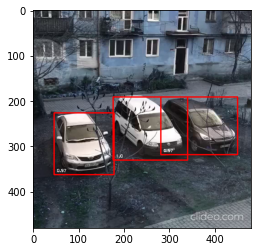

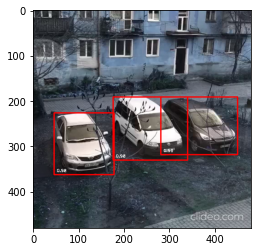

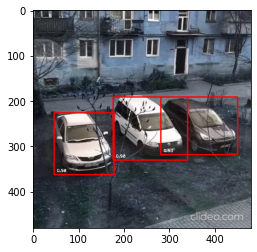

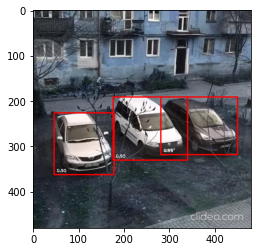

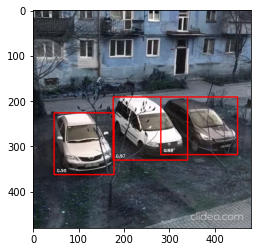

...

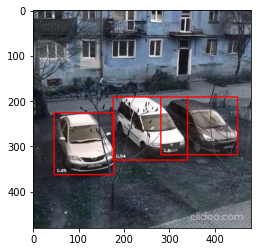

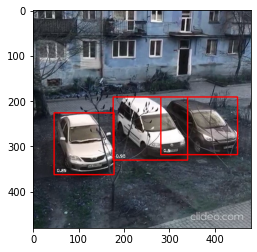

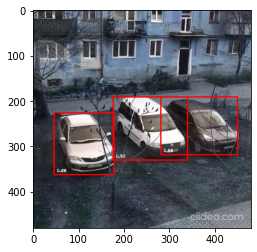

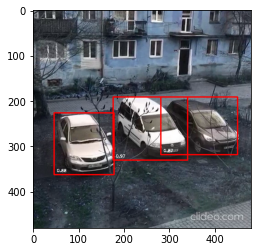

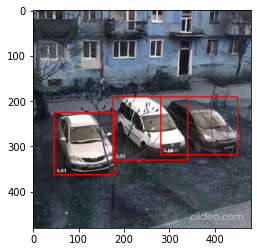

In [ ]:
import os
import numpy as np
import cv2
import mrcnn.config
import mrcnn.utils
from mrcnn.model import MaskRCNN
from pathlib import Path

!rm -r Josh
!mkdir Josh

# Configuration that will be used by the Mask-RCNN library
class MaskRCNNConfig(mrcnn.config.Config):
    NAME = "coco_pretrained_model_config"
    IMAGES_PER_GPU = 1
    GPU_COUNT = 1
    NUM_CLASSES = 1 + 80  # COCO dataset has 80 classes + one background class
    DETECTION_MIN_CONFIDENCE = 0.6


# Filter a list of Mask R-CNN detection results to get only the detected cars / trucks
def get_car_boxes(boxes, class_ids):
    car_boxes = []

    for i, box in enumerate(boxes):
        # If the detected object isn't a car / truck, skip it
        if class_ids[i] in [3, 8, 6]:
            car_boxes.append(box)

    return np.array(car_boxes)



# Root directory of the project
ROOT_DIR = Path(".")

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")

# Download COCO trained weights from Releases if needed
if not os.path.exists(COCO_MODEL_PATH):
    mrcnn.utils.download_trained_weights(COCO_MODEL_PATH)

# Directory of images to run detection on
IMAGE_DIR = os.path.join(ROOT_DIR, "Josh")

# Video file or camera to process - set this to 0 to use your webcam instead of a video file
VIDEO_SOURCE = "test_videos/7.mp4"

# Create a Mask-RCNN model in inference mode
model = MaskRCNN(mode="inference", model_dir=MODEL_DIR, config=MaskRCNNConfig())

# Load pre-trained model
model.load_weights(COCO_MODEL_PATH, by_name=True)

# Location of parking spaces
parked_car_boxes = None

# Load the video file we want to run detection on
video_capture = cv2.VideoCapture(VIDEO_SOURCE)

# How many frames of video we've seen in a row with a parking space open
free_space_frames = 0
counter=0
# Have we sent an SMS alert yet?
sms_sent = False

# Loop over each frame of video
while video_capture.isOpened():
    success, frame = video_capture.read()
    if not success:
        break

    # Convert the image from BGR color (which OpenCV uses) to RGB color
    rgb_image = frame[:, :, ::-1]

    # Run the image through the Mask R-CNN model to get results.
    results = model.detect([rgb_image], verbose=0)

    # Mask R-CNN assumes we are running detection on multiple images.
    # We only passed in one image to detect, so only grab the first result.
    r = results[0]

    # The r variable will now have the results of detection:
    # - r['rois'] are the bounding box of each detected object
    # - r['class_ids'] are the class id (type) of each detected object
    # - r['scores'] are the confidence scores for each detection
    # - r['masks'] are the object masks for each detected object (which gives you the object outline)

    if parked_car_boxes is None:
        # This is the first frame of video - assume all the cars detected are in parking spaces.
        # Save the location of each car as a parking space box and go to the next frame of video.
        parked_car_boxes = get_car_boxes(r['rois'], r['class_ids'])
    else:
        # We already know where the parking spaces are. Check if any are currently unoccupied.

        # Get where cars are currently located in the frame
        car_boxes = get_car_boxes(r['rois'], r['class_ids'])

        # See how much those cars overlap with the known parking spaces
        overlaps = mrcnn.utils.compute_overlaps(parked_car_boxes, car_boxes)

        # Assume no spaces are free until we find one that is free
        free_space = False

        # Loop through each known parking space box
        for parking_area, overlap_areas in zip(parked_car_boxes, overlaps):

            # For this parking space, find the max amount it was covered by any
            # car that was detected in our image (doesn't really matter which car)
            max_IoU_overlap = np.max(overlap_areas)

            # Get the top-left and bottom-right coordinates of the parking area
            y1, x1, y2, x2 = parking_area

            # Check if the parking space is occupied by seeing if any car overlaps
            # it by more than 0.15 using IoU
            if max_IoU_overlap < 0.15:
                # Parking space not occupied! Draw a green box around it
                cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 3)
                # Flag that we have seen at least one open space
                free_space = True
            else:
                # Parking space is still occupied - draw a red box around it
                cv2.rectangle(frame, (x1, y1), (x2, y2), (255, 0,0), 3)

            # Write the IoU measurement inside the box
            font = cv2.FONT_HERSHEY_DUPLEX
            cv2.putText(frame, f"{max_IoU_overlap:0.2}", (x1 + 6, y2 - 6), font, 0.5, (255, 255, 255))

        # If at least one space was free, start counting frames
        # This is so we don't alert based on one frame of a spot being open.
        # This helps prevent the script triggered on one bad detection.
        if free_space:
            free_space_frames += 1
        else:
            # If no spots are free, reset the count
            free_space_frames = 0

        # If a space has been free for several frames, we are pretty sure it is really free!
        if free_space_frames > 10:
            # Write SPACE AVAILABLE!! at the top of the screen
            font = cv2.FONT_HERSHEY_DUPLEX
            cv2.putText(frame, f"SPACE AVAILABLE!", (10, 150), font, 3.0, (0, 255, 0), 2, cv2.FILLED)

            # # If we haven't sent an SMS yet, sent it!
            # if not sms_sent:
            #     print("SENDING SMS!!!")
            #     message = client.messages.create(
            #         body="Parking space open - go go go!",
            #         from_=twilio_phone_number,
            #         to=destination_phone_number
            #     )
            #     sms_sent = True

        # Show the frame of video on the screen
        pt.pyplot.imshow(frame)
        pt.pyplot.show()
          #saving each frame
    name = str(counter) + ".jpg"
    name = os.path.join('./Josh', name)
    cv2.imwrite(name, frame)
    counter+=1

    # Hit 'q' to quit
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Clean up everything when finished
video_capture.release()
cv2.destroyAllWindows()

### **Convert Images to videos**

In [ ]:
import glob


def Images_to_video(images_dir,outvid, fps=30, size=None,
               is_color=True, format="FMP4"):
   # Get all image file paths to a list.
    images = list(glob.iglob(os.path.join(images_dir, '*.*')))
    # Sort the images by name index
    images = sorted(images, key=lambda x: float(os.path.split(x)[1][:-3]))

    """
    Create a video from a list of images.
 
    @param      outvid      output video
    @param      images      list of images to use in the video
    @param      fps         frame per second
    @param      size        size of each frame
    @param      is_color    color
    @param      format      see http://www.fourcc.org/codecs.php
    @return                 see http://opencv-python-tutroals.readthedocs.org/en/latest/py_tutorials/py_gui/py_video_display/py_video_display.html
    """
    from cv2 import VideoWriter, VideoWriter_fourcc, imread, resize
    fourcc = VideoWriter_fourcc(*format)
    vid = None
    for image in images:
        if not os.path.exists(image):
            raise FileNotFoundError(image)
        img = imread(image)
        if vid is None:
            if size is None:
                size = img.shape[1], img.shape[0]
            vid = VideoWriter(outvid, fourcc, float(fps), size, is_color)
        if size[0] != img.shape[1] and size[1] != img.shape[0]:
            img = resize(img, size)
        vid.write(img)
    vid.release()
    return vid

vid_name = 'output_video4.mp4'
images_dir = 'Josh'
Images_to_video(images_dir, vid_name, fps=5)  
print('Video generation complete')

Video generation complete


### **Work in Progress**

In [1]:
import numpy as np
import cv2
import mrcnn.utils
from mrcnn.model import MaskRCNN
from mrcnn.config import Config
from pathlib import Path
# from redisClient import RedisClient
# from mysqlClient import MysqlClient
# import constants

# Mask-RCNN config declaration
class MaskRCNNConfig(Config):
  NAME = "coco_pretrained_model_config"
  IMAGES_PER_GPU = 1
  GPU_COUNT = 1
  NUM_CLASSES = 1 + 80
  DETECTION_MIN_CONFIDENCE = 0.6
  VALIDATION_STEPS = 5
  STEPS_PER_EPOCH = 50


class FreeParkingDetector:
  def __init__(self):
    # self.mysqlClient = MysqlClient()
    # self.redisClient = RedisClient()
    self.PARKING_ID = 1
    self.ROOT_DIR = Path(".")
    self.MODEL_DIR = self.ROOT_DIR / "logs"
    self.COCO_MODEL_PATH =os.path.join(ROOT_DIR, "mask_rcnn_coco.h5") # self.ROOT_DIR / "coco20190321T1800/mask_rcnn_coco_0001.h5"
    self.IMAGE_SOURCE = None
    self.VIDEO_SOURCE = "test_videos/7.mp4" #self.get_camera_path()
    self.SAVED_IMAGES_DIR = "savedImages"

  def get_camera_path(self):
    path = 0
    configuration = self.mysqlClient.select_parking_camera_configuration(str(self.PARKING_ID))
    if configuration:
      for c in configuration:
        if c[constants.CAMERA_FIRST_IMAGE]:
          self.IMAGE_SOURCE = c[constants.CAMERA_FIRST_IMAGE]
        if c[constants.CAMERA_TEST_CONFIG]:
          return c[constants.CAMERA_TEST_CONFIG]
        path = "rtsp://" + c[constants.CAMERA_USERNAME] + ":" + c[constants.CAMERA_PASS] + "@" + c[constants.CAMERA_IP]
      return path
    return path

  # Delete 'not cars' from found objects
  def getCarsObjects(self, objects, classes):
    car_boxes = []
    # 3 - car, 6 - bus, 8 - truck
    cars_classes = [3, 6, 8]
    for i, obj in enumerate(objects):
      if classes[i] in cars_classes:
        car_boxes.append(obj)
    return np.array(car_boxes)


  def process_available_parking(self, info, frame, additional):
    userId = info['userId']
    parkingId = info['parkingId']
    if int(parkingId) == self.PARKING_ID:
      savedFileName = self.SAVED_IMAGES_DIR + "/usr" + str(userId) + "_p" + str(parkingId) + ".jpg"
      cv2.imwrite(savedFileName, frame)
      return {
      'success': True,
      'foundPlaces': True,
      'allPlaces': additional['allPlaces'],
      'freePlaces': additional['freePlaces'],
      'file': savedFileName,
      'userId': userId,
      'parkingId': parkingId
      }
    return {
    'success': False
    }

  def process_unavailable_parking(self, info, frame, additional):
    userId = info['userId']
    parkingId = info['parkingId']
    if int(parkingId) == self.PARKING_ID:
      return {
      'success': True,
      'foundPlaces': False,
      'allPlaces': additional['allPlaces'],
      'freePlaces': additional['freePlaces'],
      'userId': userId,
      'parkingId': parkingId
      }
    return {
    'success': False
    }
  def run(self):
    # Create Mask-RCNN model.
    model = MaskRCNN(mode="inference", model_dir=self.MODEL_DIR,
    config=MaskRCNNConfig())
    # Load pre-trained model
    model.load_weights(self.COCO_MODEL_PATH.__str__(), by_name=True)
    parked_car_boxes = None
    video_capture = cv2.VideoCapture(self.VIDEO_SOURCE)
    first_image = cv2.imread(self.IMAGE_SOURCE)
    free_space_frames = 0
    results = []
    frames_counter = 0
    check_requests_counter = 0
    # Get single capture in loop.
    while video_capture.isOpened():
      success, frame = video_capture.read()
      if parked_car_boxes is None:
        frame = first_image
        frames_counter += 1
        check_requests_counter += 1
      if not success:
        break
      # Convert img to RGB
      rgb_image = frame[:, :, ::-1]

      # Use Mask R-CNN detect method for getting results of distinguishing
      if frames_counter > 40 or not results:
        results = model.detect([rgb_image], verbose=0)
        frames_counter = 0
      r = results[0]

      if parked_car_boxes is None:
        # Get start parking condition. All parking place are unavailable
        parked_car_boxes = self.getCarsObjects(r['rois'], r['class_ids'])
      else:
        # Check free parking places
        # Get all cars on current capture.
        car_boxes = self.getCarsObjects(r['rois'], r['class_ids'])
        # Count overlaps between parked_cars condition and current condition
        overlaps = mrcnn.utils.compute_overlaps(parked_car_boxes, car_boxes)
        # Currently we have not free places
        free_space = False
        all_parking_places = 0
        free_parking_places = 0
      for parking_area, overlap_areas in zip(parked_car_boxes, overlaps):
        # Get max IoU value
        max_IoU_overlap = np.max(overlap_areas)
        y1, x1, y2, x2 = parking_area
        all_parking_places += 1
        # Check availability of parking place by IoU value
        if max_IoU_overlap < 0.15:
          # Place is free. Draw green rectangle
          cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 1)
          free_parking_places += 1
          free_space = True
        else:
          # Place is not free. Draw red rectangle
          cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 0, 255), 1)
      additional_parking_info = {
      "allPlaces": all_parking_places,
      "freePlaces": free_parking_places
      }
      if free_space:
        free_space_frames += 1
      else:
        free_space_frames = 0

      if free_space_frames > constants.WAIT_FRAMES_COUNT:
        # Free parking place found.
        self.redisClient.process_bot_request(
        frame,
        additional_parking_info,
        self.process_available_parking
        )
      elif check_requests_counter > constants.WAIT_FRAMES_COUNT:
        self.redisClient.process_bot_request(frame, additional_parking_info, self.process_unavailable_parking)

      # cv2.imshow('Video', frame)
      # Show the frame of video on the screen
      pt.pyplot.imshow(frame)
      pt.pyplot.show()
      if cv2.waitKey(1) & 0xFF == ord('q'):
        break
    video_capture.release()
    cv2.destroyAllWindows()

detector = FreeParkingDetector()
detector.run()


ModuleNotFoundError: ignored